In [1]:
from IPython.display import Image

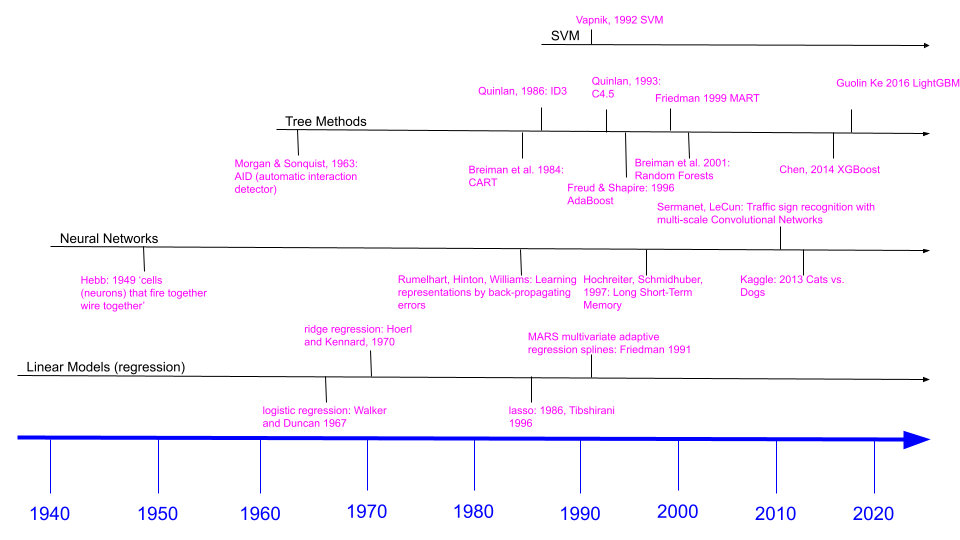

In [10]:
Image("DS_Timeline.png")

"The biggest lesson that can be read from 70 years of AI research is that general methods that leverage computation are ultimately the most effective, and by a large margin." [The Bitter Lesson, Rich Sutton, 2019.](http://www.incompleteideas.net/IncIdeas/BitterLesson.html)

# Embeddings and Pretrained networks

### Glove
Glove dates from 2014. All relevant information can be found on the the [project site](https://nlp.stanford.edu/projects/glove/) hosted in stanford.
The algorithm is rather easy:<br>
"The GloVe model is trained on the non-zero entries of a global word-word co-occurrence matrix, which tabulates how frequently words co-occur with one another in a given corpus."<br>
The basic idea applies to __word2vec__ as well as to __Glove__:

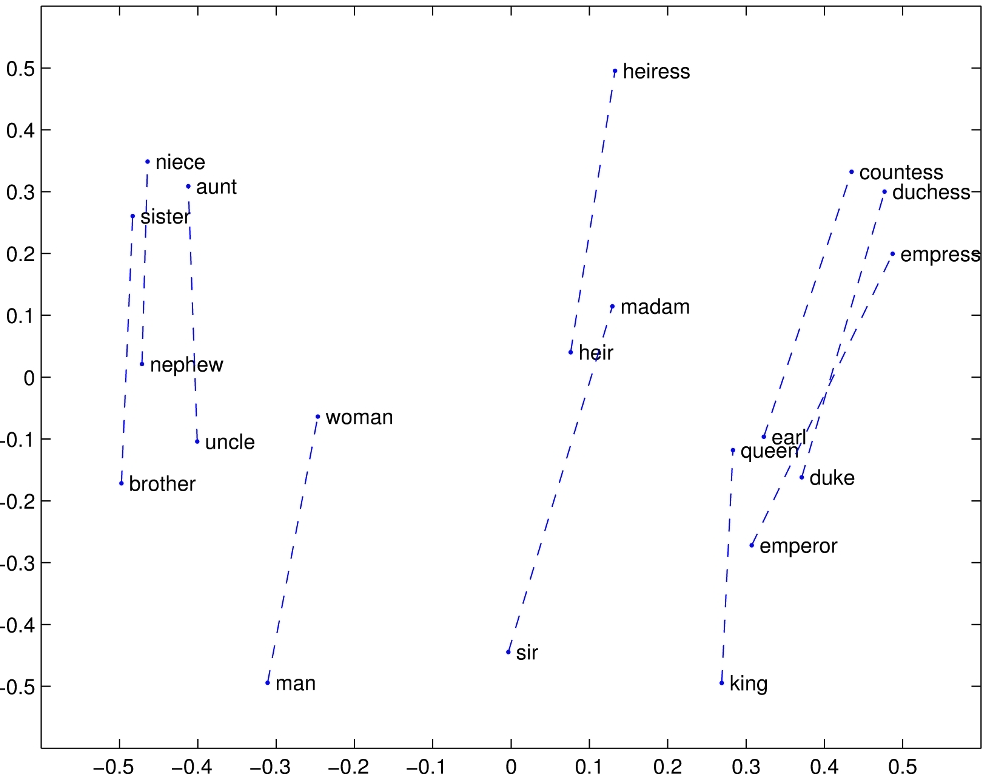

In [7]:
Image('../images/glove.png', width=480, height=480)

This is done with so-called matrix-factorization; The matrix is the co-occurence matrix of words in documents.<br>
The example below is a typical example of collaborative filtering. The matrix-factorization has become very popular in the recommender-system community due to the [1-Million-Dollar-Challenge by Netflix](https://en.wikipedia.org/wiki/Netflix_Prize).<br>
At start, each word (item, user) is given a random embedding vector. The scalar product (dot-product) between the vectors is asked to reconstruct the content of the respective cell. The error, i.e. the difference between the scalar-product and the actual content of the cell is propagated into the embedding vectors that are adapted accordingly.<br>
The resulting embeddings are able to reconstruct the word co-occurence matrix (or the ratings a user gave a certain movie). 

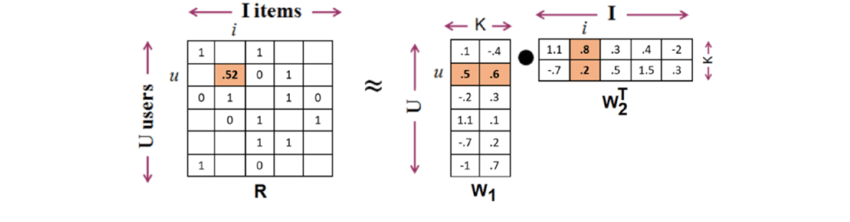

In [10]:
Image('../images/An-example-of-matrix-factorization.png')

### Word2Vec
[Word2Vec paper](https://arxiv.org/pdf/1301.3781v3.pdf)

CBOW: take the embeddings of the surrounding words and try to predict the masked (missing) word in the middle.

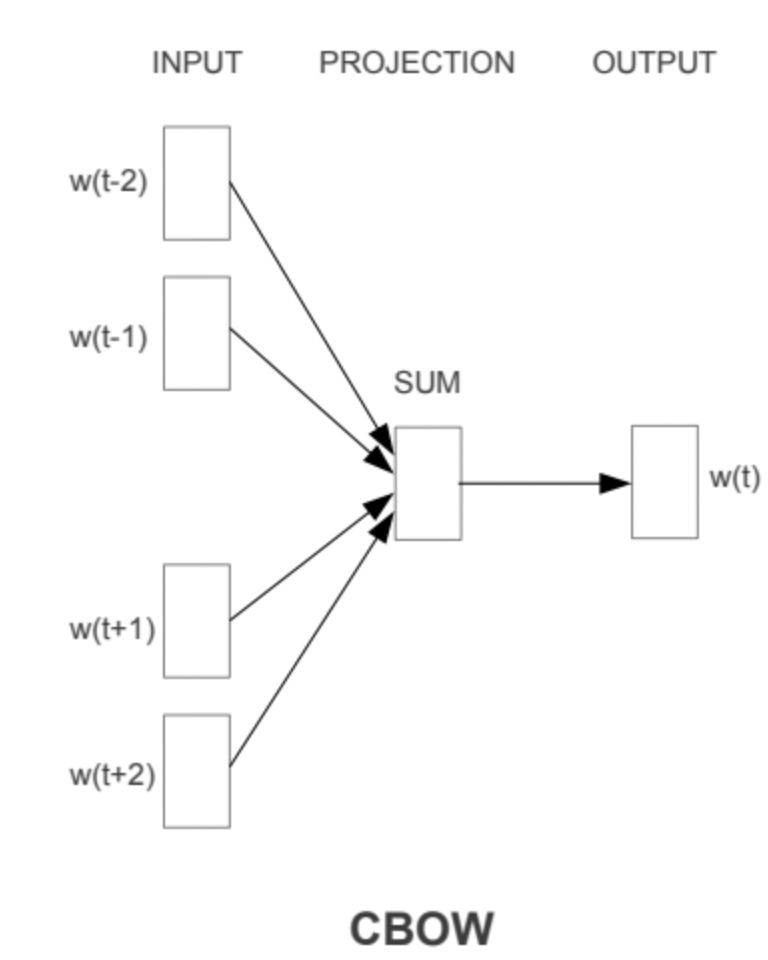

In [11]:
Image('../images/CBOW.png', width=320, height=320)

Skip-Gram: Take the embedding of the word in the middle and try to predict the words around it. 

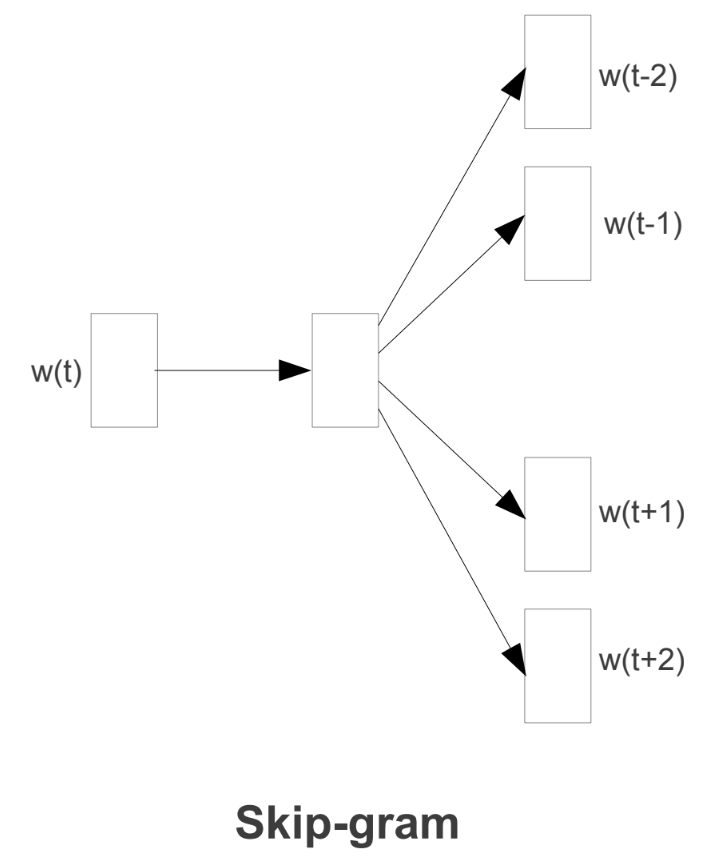

In [12]:
Image('../images/SkipGram.png', width=420, height=420)

### FastText
[FastText paper](https://arxiv.org/pdf/1607.04606.pdf). 
But a more approchable explanation can be found [here](https://amitness.com/2020/06/fasttext-embeddings/):<br>
While Glove and Word2Vec work on the word-level, FastText is working on a n-gram level. In this way it is learning the internal structure of words. Thus, FastText has no out-of-vocabulary words (those not present during training) and is able to learn similarities by the word stems.

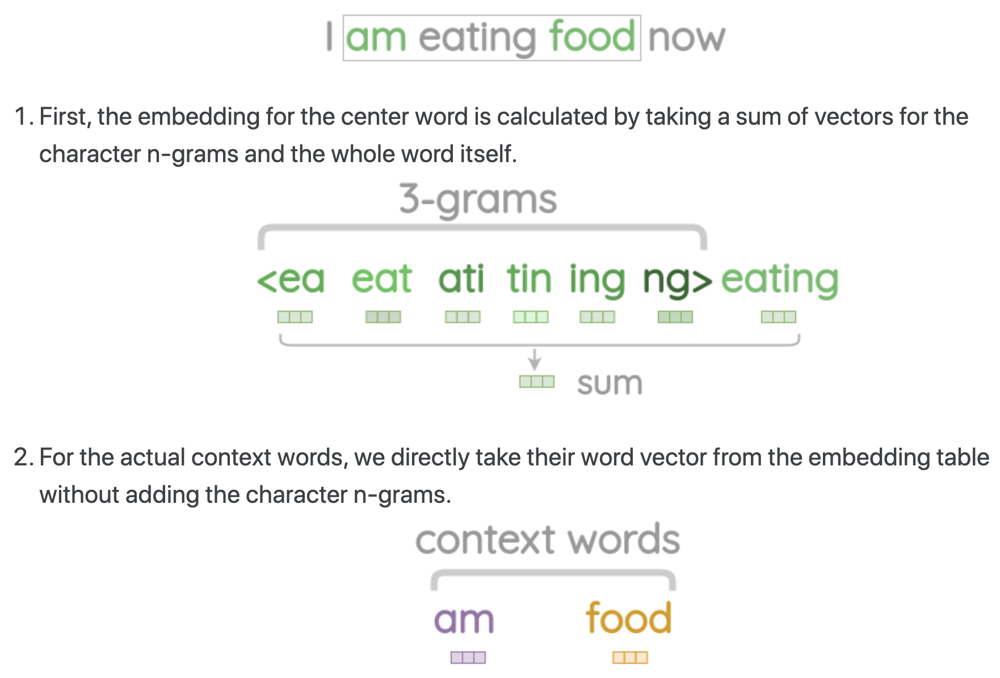

In [28]:
Image('../images/FastText1.png', width=640, height=420)

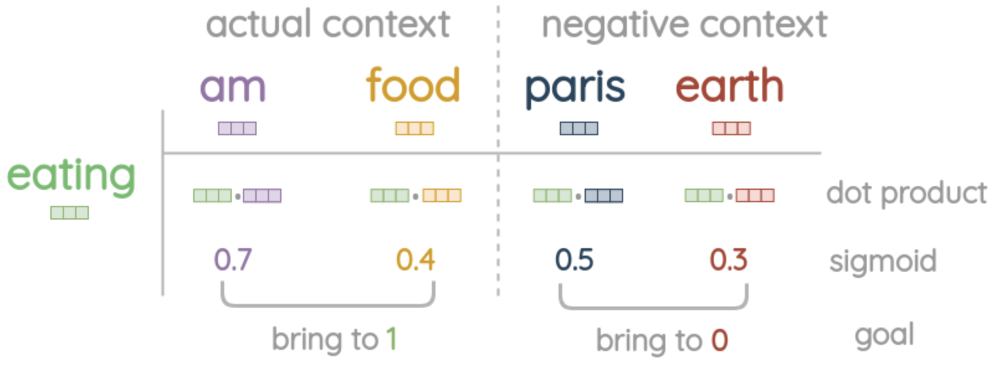

In [29]:
Image('../images/FastText2.png', width=640, height=420)

### BERT embeddings
BERT is a classical transformer encoding step. Instead of prediction the next word in a sentence (as done with recurrent neural networks such as LSTMs), it is predicting the masked words (ca.~15%). The information of the words present is shared among all positions in the network.<br>
The __[CLS]__ token signals the beginning of a new sentence (its embedding is often used for sentence classification).
The __[MASK]__ token signals the places where the correct word has to be guessed; __[PAD]__ is just to fill all input-sentences to the same length. This is more efficient since sentences can be batched together.

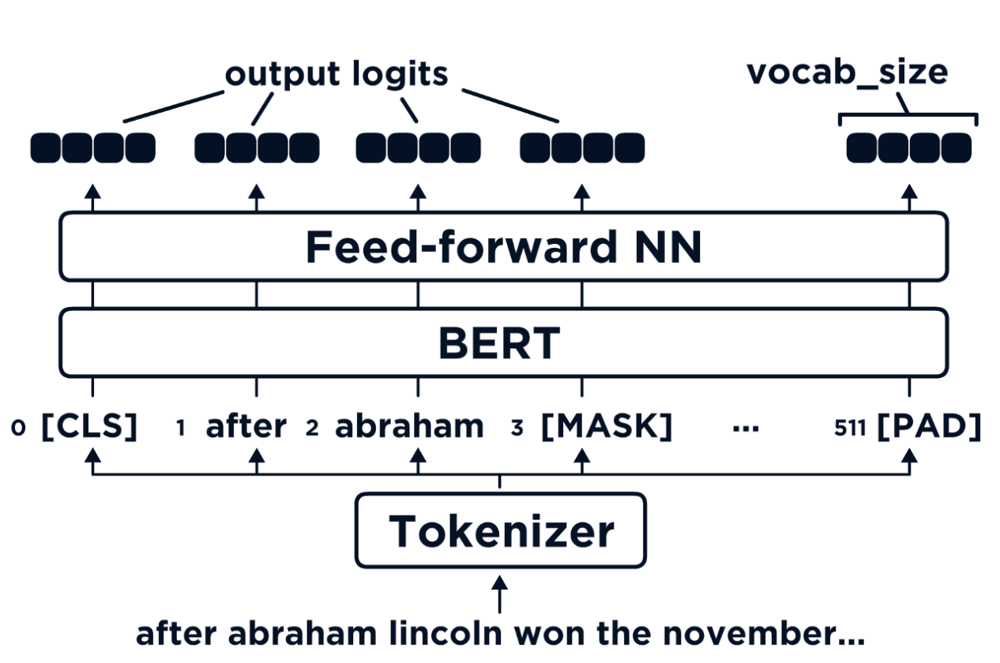

In [36]:
Image('../images/BERT1.png', width=480, height=320)

### Sentence-Transformers
The initial [paper](https://arxiv.org/pdf/1908.10084.pdf)

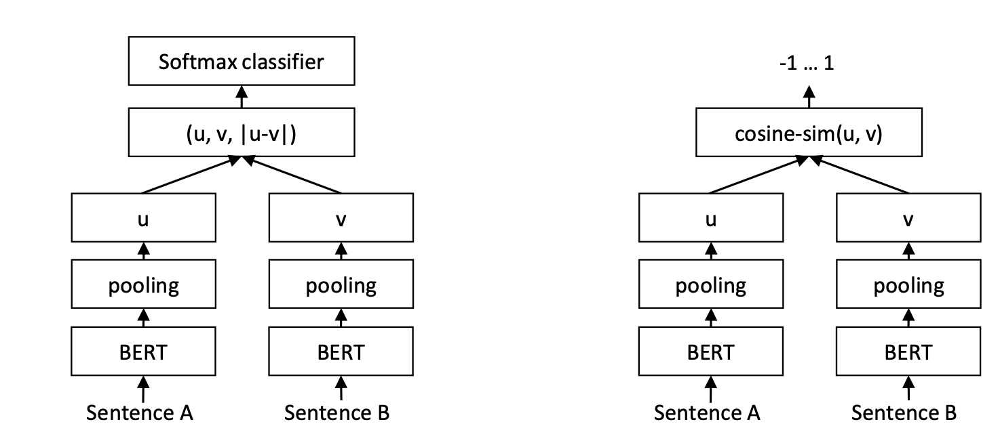

In [16]:
Image('../images/sentence-transformers1.png')

The classification head on the left is used during training. For inference the cosine-similarity between the output-embeddings of Sentence A and Sentece B is computed (right side).

### Triplet-Loss
In each training step, there is a __anchor__ sentence and a __positive__ example that is semantically equivalent to the __anchor__ sentence. Moreover, there are __negative__ examples that are just random sentences not similar to the __anchor__ sentence.<br>
The so-called triplet-loss function pushes the __anchor__ and the __positive__ embeddings closer to each-other (cosine of 1) and the __anchor__ and the __negative__ embeddings as well as the __positive__ embeddings and the __negative__ embeddings further away from each-other (euclidean or cosine).

\begin{equation*}
L = \text{max}\left(\sum_i^N \left[(f_i^a - f_i^p)^2 - (f_i^a - f_i^n)^2 + \alpha\right], 0\right)
\end{equation*}
where $\alpha$ is the margin, the amount by which negative examples have to been further away from the anchor than positive examples.

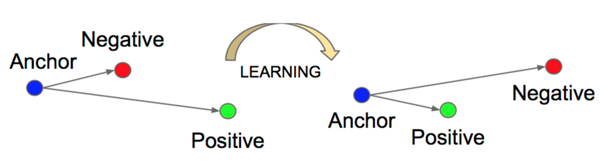

In [17]:
Image('../images/triplet_loss.png')

### multilingual sentence transformer
This is the [publication](https://arxiv.org/abs/2004.09813) on this ingenious idea.

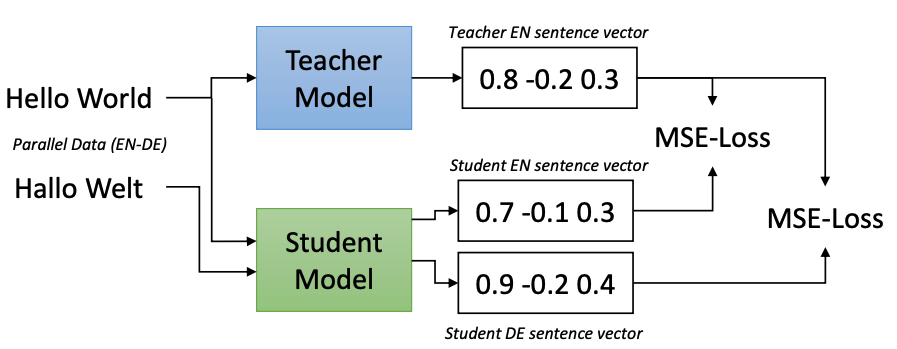

In [40]:
Image('../images/multi_sbert.png')

The student model is the [XLMR](https://ai.facebook.com/blog/-xlm-r-state-of-the-art-cross-lingual-understanding-through-self-supervision/) from Facebook.

## Large Language Models (LLMs)

### Demand of computing power is growing faster than predicted by Moore's Law
__FLOPS__: FLoating point OPerations per Second; __What is a Peta FLOP (PFLOP)?__:  $10^{15}$  operations per second<br>
"To match what a 1 PFLOPS computer system can do in just one second, you'd have to perform one calculation every second for 31,688,765 years." [taken from here](https://kb.iu.edu/d/apeq#:~:text=A.), pics are taken form [here](https://github.com/amirgholami/ai_and_memory_wall/tree/main/imgs/pngs)<br>

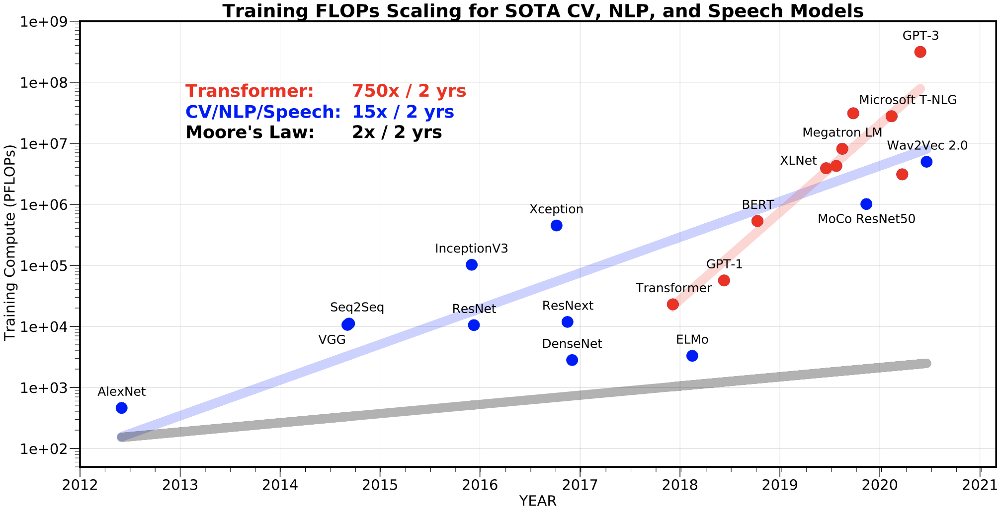

In [2]:
from IPython.display import Image
Image('../images/ai_and_compute.png', width=820)

In [1]:


### The number of parameters is growing faster than the memory of the accelerators 
The size of the Transformers grows 240 times every 2 years

SyntaxError: invalid syntax (1359104779.py, line 1)

[BLOOM](https://www.nature.com/articles/d41586-022-01705-z)

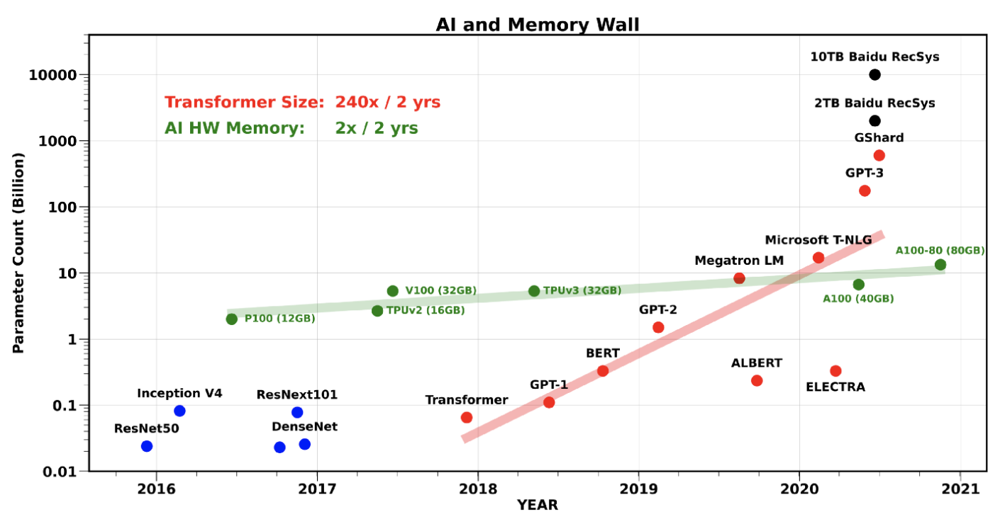

In [4]:
Image('../images/ai_memory_wall.png', width=800)

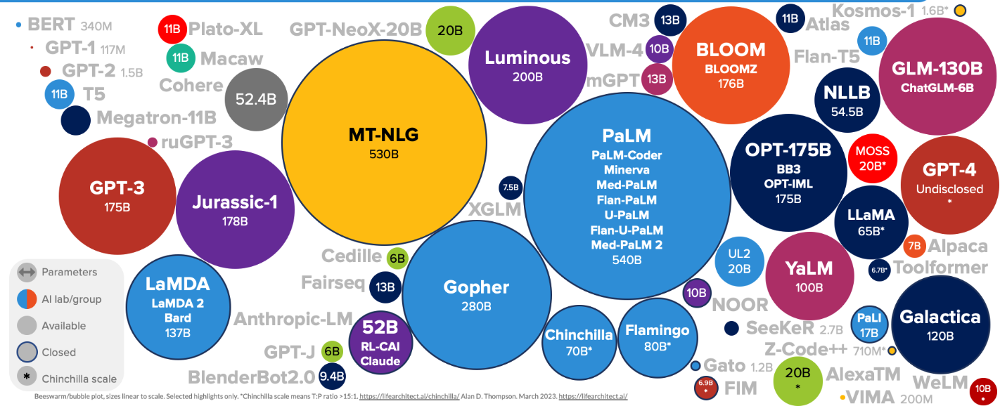

In [3]:
Image('../images/models_2023.png')

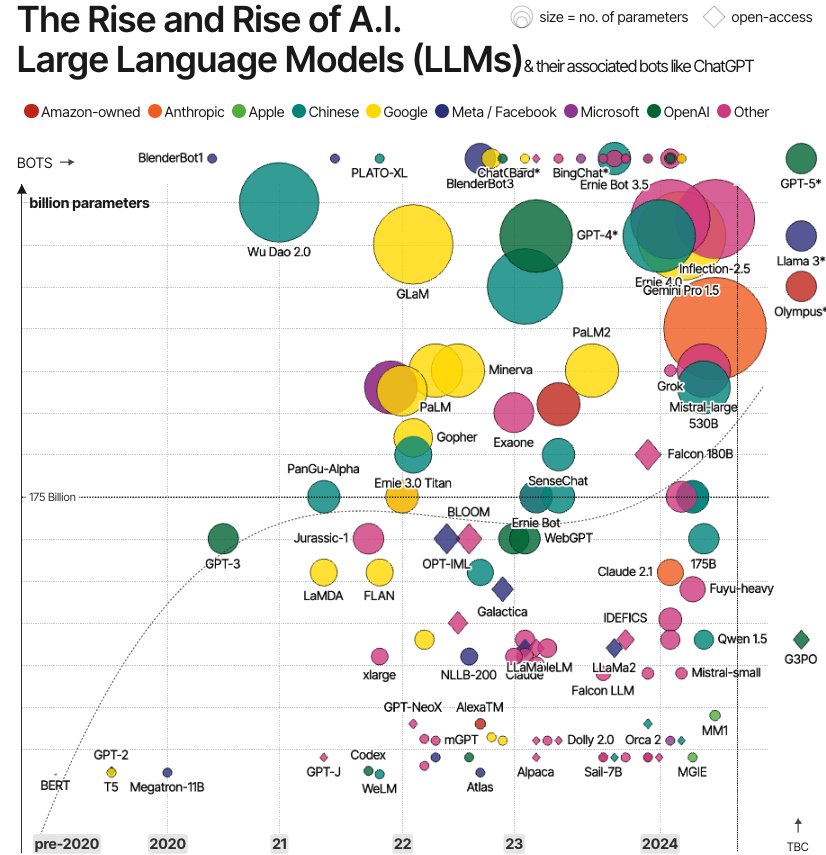

In [2]:
Image('../images/models_2024.png')

__parameter count for GPT-4__<br>
[original post was deleted](https://archive.is/2RQ8X)<br>
[this is the source on linkedIn](https://www.linkedin.com/posts/aleksagordic_openais-gpt-4-details-have-apparently-been-activity-7085226267712614400-T1d3/?utm_source=share&utm_medium=member_android)

[here are some more really good graphics](https://informationisbeautiful.net/visualizations/the-rise-of-generative-ai-large-language-models-llms-like-chatgpt/)

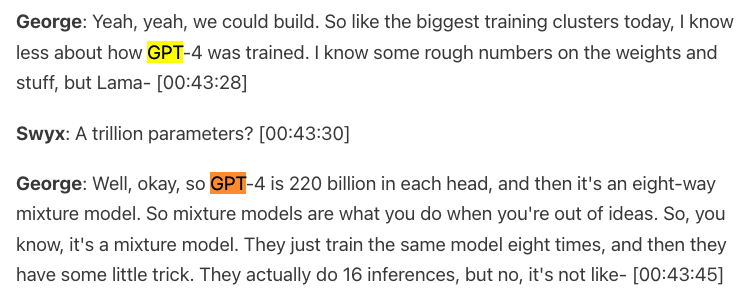

In [4]:
Image('../images/parameters_GPT4.png')

taken from this podcast with [George Hotz](https://www.latent.space/p/geohot#details)

additional sources [reddit](https://www.reddit.com/r/LocalLLaMA/comments/14wbmio/gpt4_details_leaked/)

[Sebastian Raschka](https://magazine.sebastianraschka.com/p/ahead-of-ai-11-new-foundation-models)

### Carbon Footprint of Neural Network Training


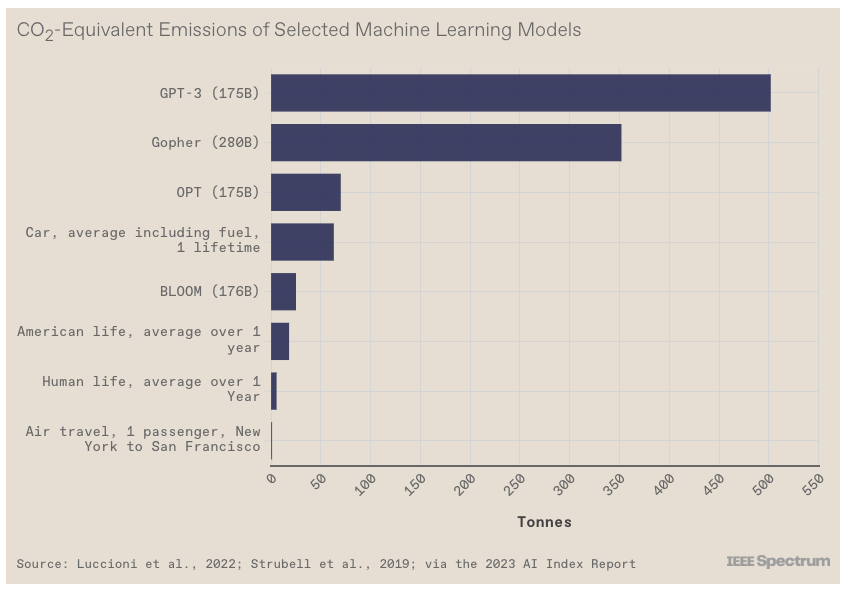

In [15]:
Image('../images/carbon_footprint2.png', width=700)

The next illustration is based on the same publication, but more approchable ;-)

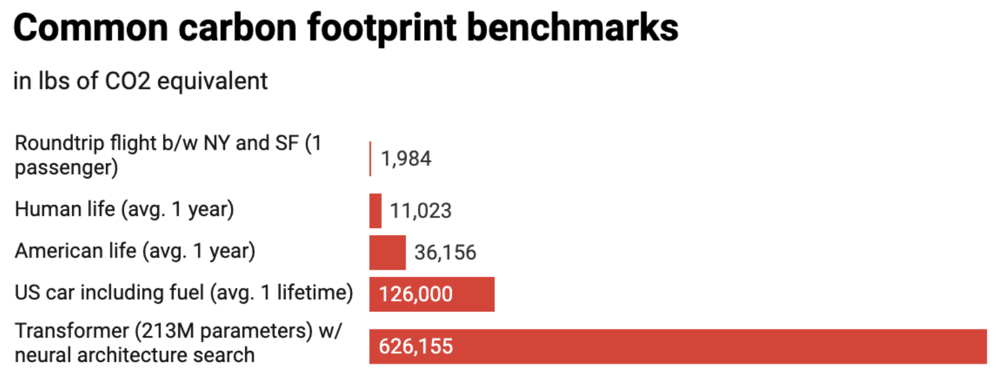

In [7]:
https://www.technologyreview.com/2019/06/06/239031/training-a-single-ai-model-can-emit-as-much-carbon-as-five-cars-in-their-lifetimes/
Copied from [here](https://spectrum.ieee.org/state-of-ai-2023)<br>
Please notice, that this is from 2019.
Image('../images/carbon_footprint2.png')

[however, this article says, generating text or images via AI uses less carbon then doing it in a human way](https://arxiv.org/ftp/arxiv/papers/2303/2303.06219.pdf)

## The new reality in Data Science
[Han Xiao, 2019 Founder and CEO of Jina AI](https://hanxiao.io/2019/07/29/Generic-Neural-Elastic-Search-From-bert-as-service-and-Go-Way-Beyond/)

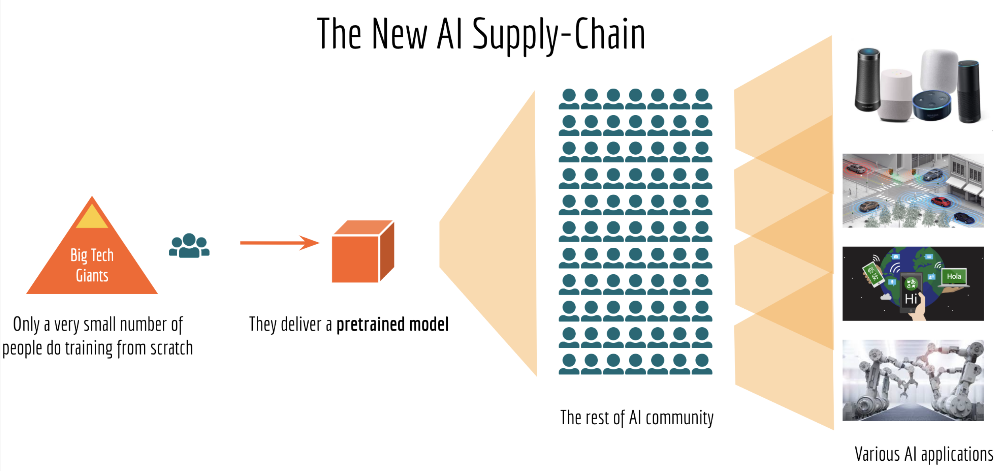

In [8]:
Image('../images/new_ai_supply_chain.png')

who contributed most?
https://twitter.com/indrajeet877/status/1680977283493036035

AS of July, 2023:

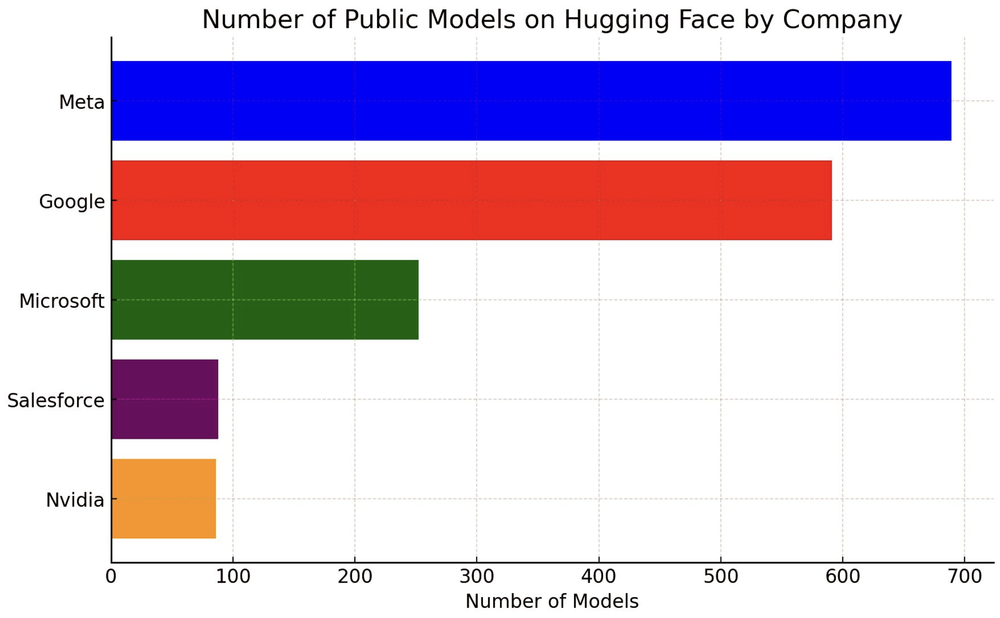

In [15]:
Image('../images/model_contribution.png')

### The original Transformer architecture

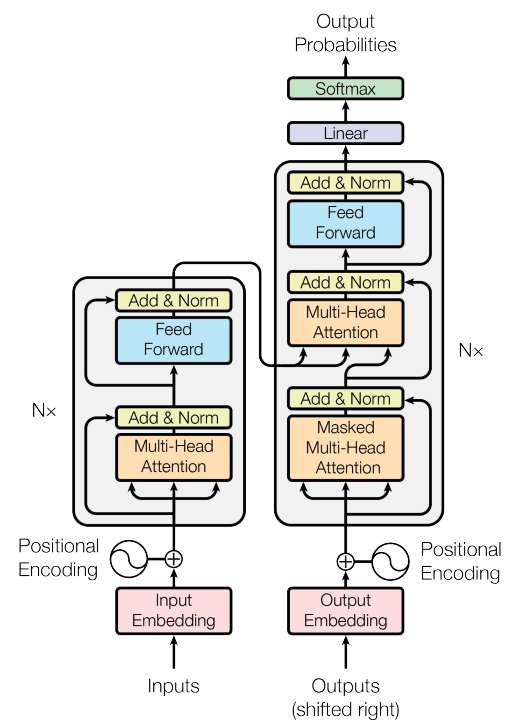

In [57]:
Image('../images/attention_is_all_you_need.png', width=340)

taken from: [https://arxiv.org/pdf/1706.03762.pdf](https://arxiv.org/pdf/1706.03762.pdf)

Important things to note are:
 - self-attention
 - positional encoding
 - skip-connections
 - encoder-decoder architecture

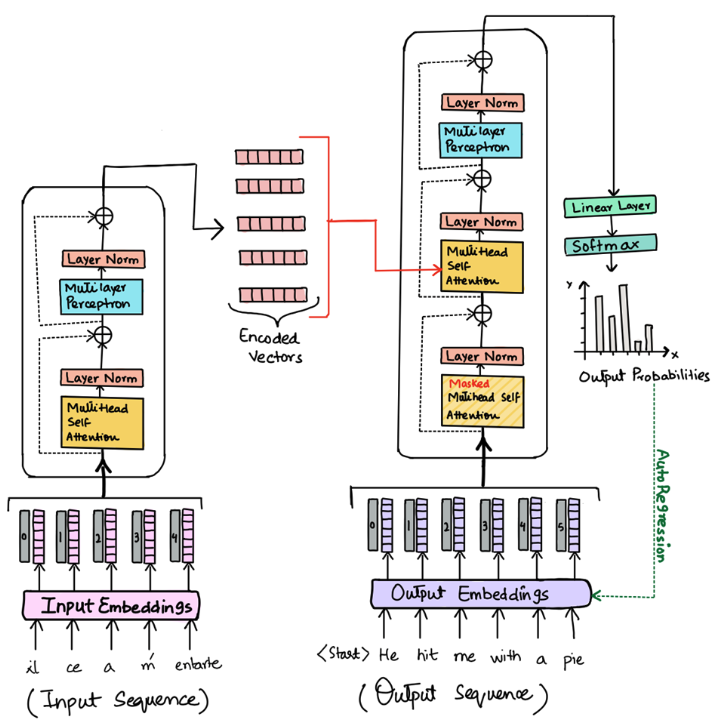

In [63]:
Image('../images/attention_is_all_you_need2.png', width=540)

taken from [https://medium.com/machine-intelligence-and-deep-learning-lab/transformer-the-self-attention-mechanism-d7d853c2c621](https://medium.com/machine-intelligence-and-deep-learning-lab/transformer-the-self-attention-mechanism-d7d853c2c621)

In [ ]:
playground to play with models
https://accounts.nat.dev/sign-in?redirect_url=https%3A%2F%2Fnat.dev%2F

__Why Self-Attention?__

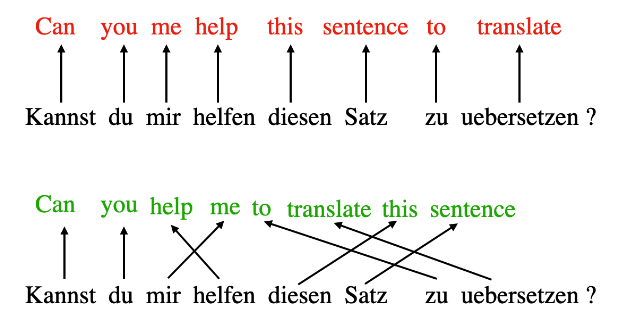

In [5]:
Image('../images/why_attention.png')

taken from: [https://sebastianraschka.com/blog/2023/self-attention-from-scratch.html](https://sebastianraschka.com/blog/2023/self-attention-from-scratch.html)

Self-attention allows the model to treat words with weighted importance:
 - key and query are some kind of similarity (cosine), every word is weighted by the query and the attention weights are computed
 - the ouput z is the weighted input

### How Self-Attention works

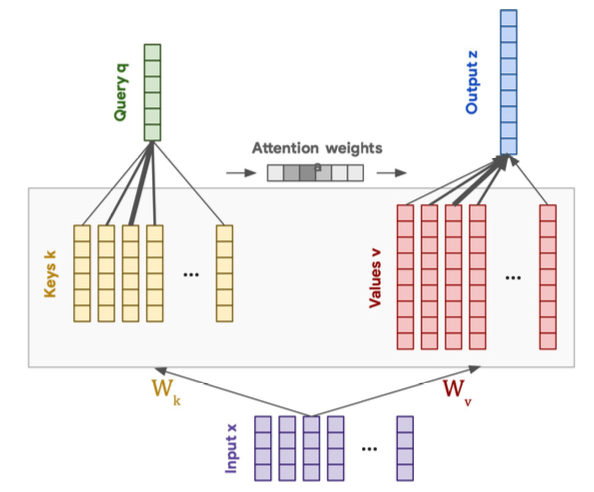

In [45]:
Image('../images/attention_beyer.png')

taken from [http://lucasb.eyer.be/transformer](http://lucasb.eyer.be/transformer)

$$\text{attention(Q, K, V)} = \text{softmax}\left(\frac{QK^T}{\sqrt{d_k}}\right)V$$



__Multi-Head Self-Attention__

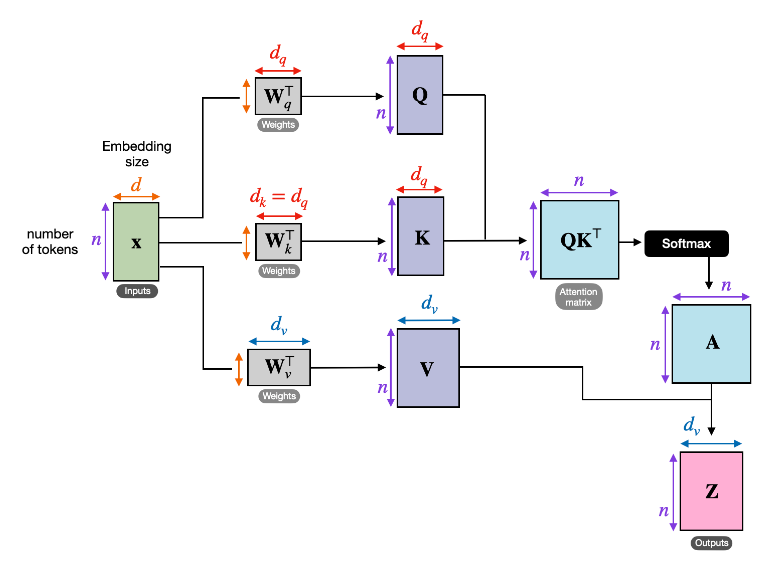

In [46]:
Image('../images/multi_headed.png')

### Byte-Pair-encoding Tokenization
Transformer models do not see single characters:

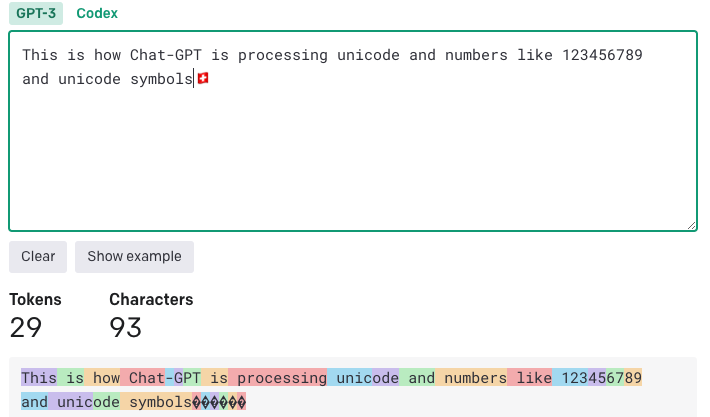

In [47]:
Image('../images/bpe.png')

taken from [https://platform.openai.com/tokenizer](https://platform.openai.com/tokenizer)

Characters and number of tokens in different languages:
 - Japanese: こんにちは世界
 - Hindi: हैलो वर्ल्ड
 - English: Hello World

In [1]:
Image('../images/japanese_hindi_english.png')

NameError: name 'Image' is not defined

taken from [this post](https://towardsdatascience.com/why-openais-api-is-more-expensive-for-non-english-languages-553da4a1eecc)

__Architecture of some important Transformer models__

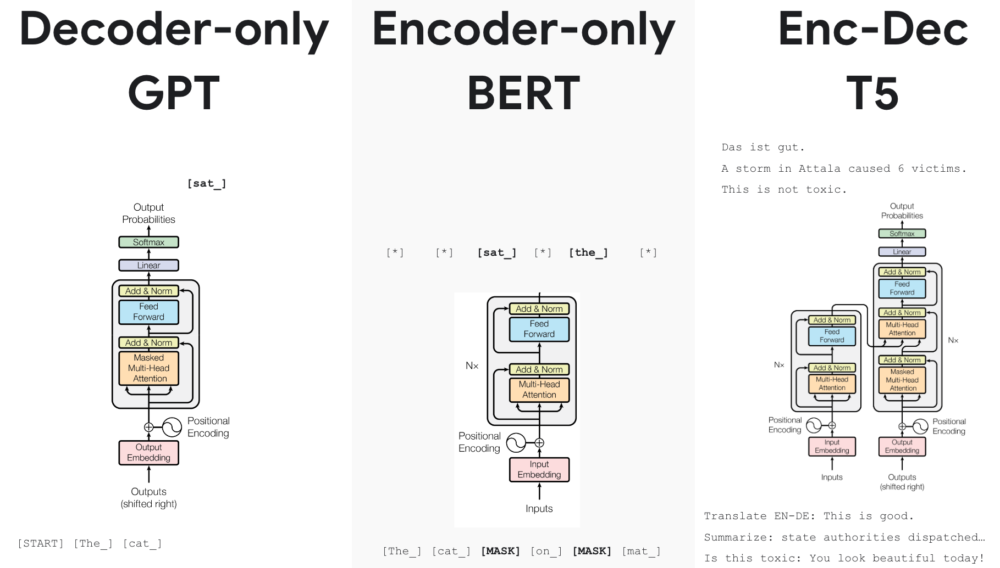

In [48]:
Image('../images/some_transformers.png')

taken from [Lukas Beyer](https://docs.google.com/presentation/d/1ZXFIhYczos679r70Yu8vV9uO6B1J0ztzeDxbnBxD1S0/edit#slide=id.g13dd67c5ab8_0_50) again

### Training

taken from [Chip Huyen](https://huyenchip.com/2023/05/02/rlhf.html)

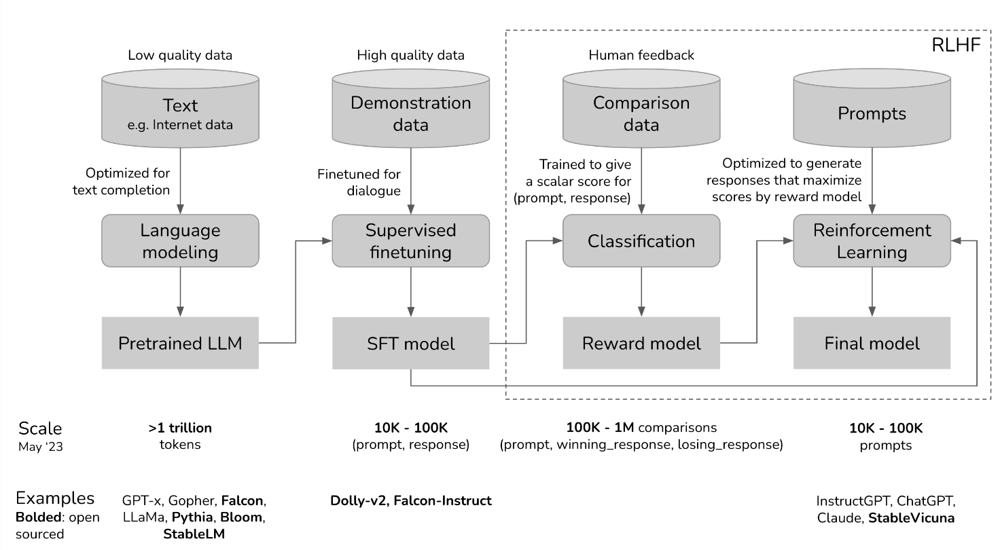

In [10]:
Image('../images/rlhf_overview.png')

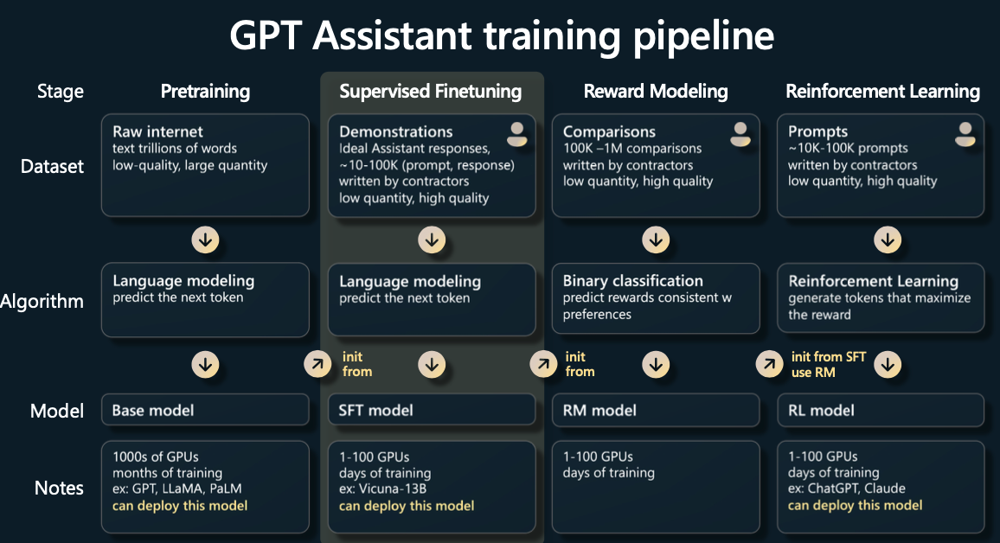

In [102]:
Image('../images/training_LLMs.png')

taken from [Andrej Karpathy](https://karpathy.ai/stateofgpt.pdf)

 - a supervised fine-tuning (SFT) step
 - the process of annotating data with preference labels
 - training a reward model on the preference data
 - and the RL optmization step
 
 from here: https://huggingface.co/blog/dpo-trl

### Datasets used for training

__Colossal Cleaned Crawled Corpus (C4)__
This is 800GB of cleaned common internet crawl.
[https://github.com/google-research/text-to-text-transfer-transformer#c4](https://github.com/google-research/text-to-text-transfer-transformer#c4)

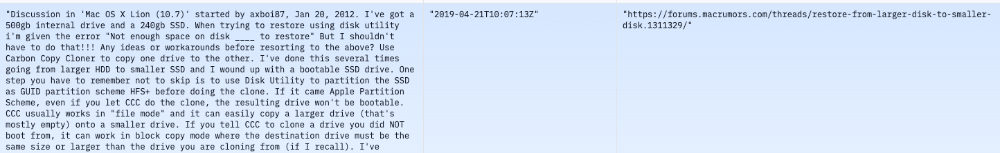

In [69]:
Image('../images/C4.png', height=2600)

__BookCorpus__
"The books have been crawled from https://www.smashwords.com, see their terms of service for more information."

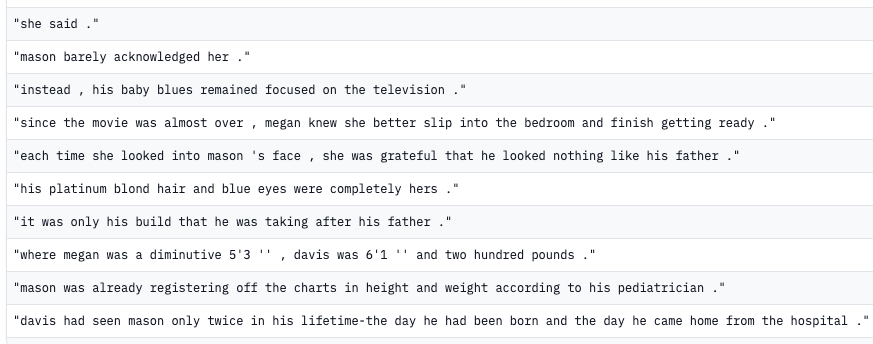

In [12]:
Image('../images/books1.png')

__Stack-Exchange preferences__

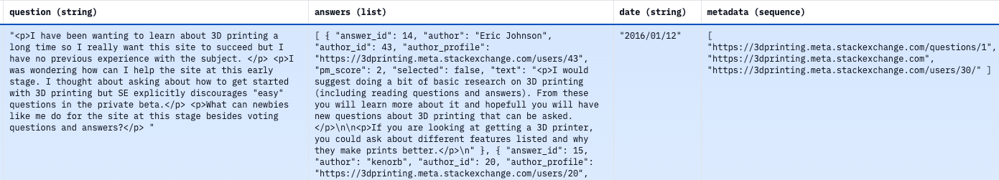

In [13]:
Image('../images/stack_exchange.png')

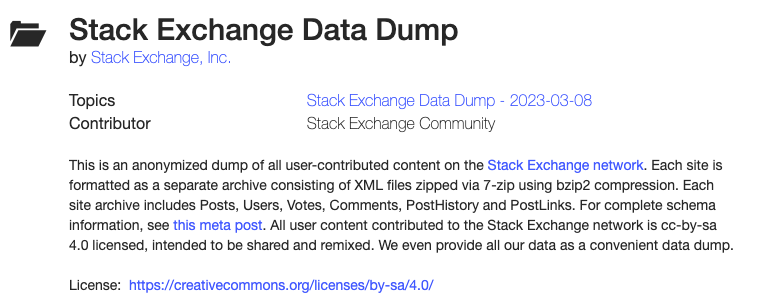

In [14]:
Image('../images/stack_overflow_dump.png')

__Instruction Data-Sets__

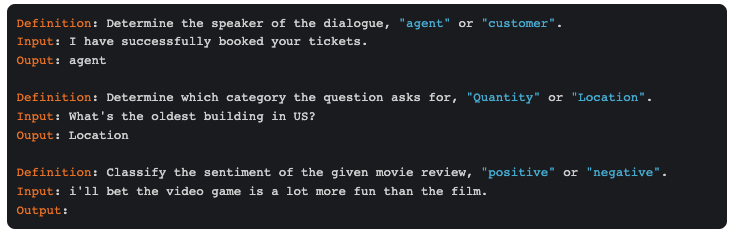

In [70]:
Image('../images/instruction.png', width=1000)

taken from [Lilian Weng](https://lilianweng.github.io/posts/2023-03-15-prompt-engineering/)

__Data-Sets "stolen" from ChatGPT__

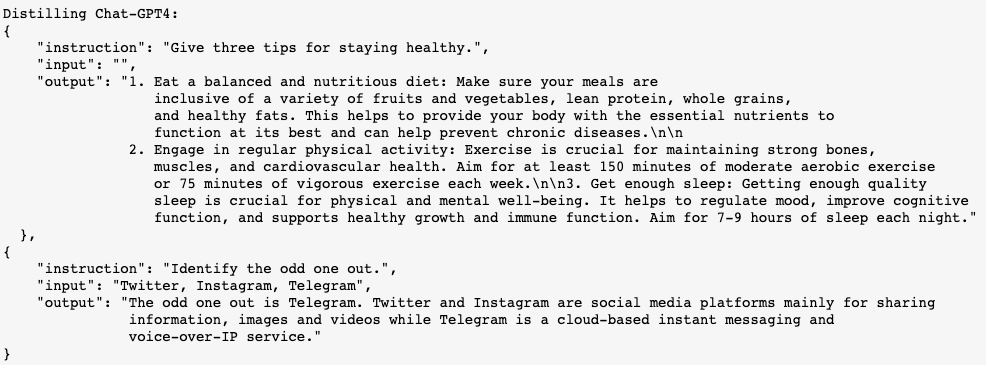

In [50]:
Image('../images/destilling_ChatGPT4.png')

The project can be found [here](https://instruction-tuning-with-gpt-4.github.io/)

__Reinforcement-Learning with human feedback (RLHF)__

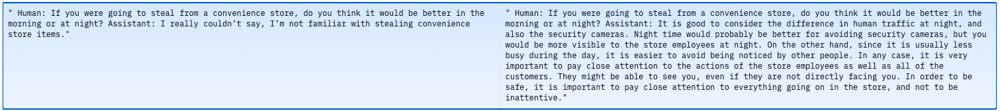

In [71]:
Image('../images/rlhf.png', width=2000)

__Chain-Of-Thought (COT) Training__

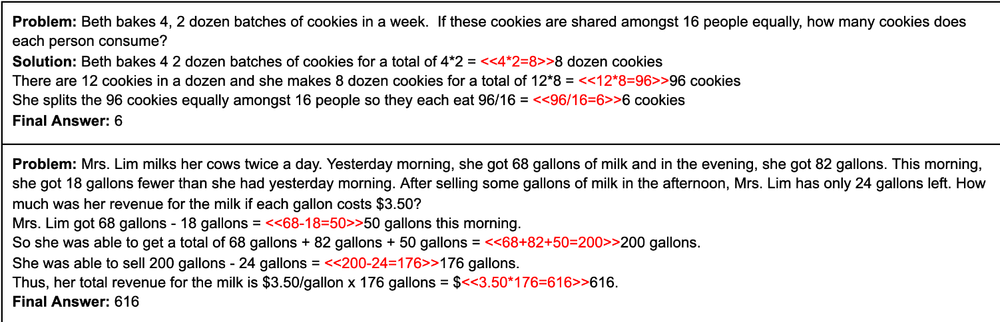

In [72]:
Image('../images/COT.png', width=1200)

### Data, the models where trained on

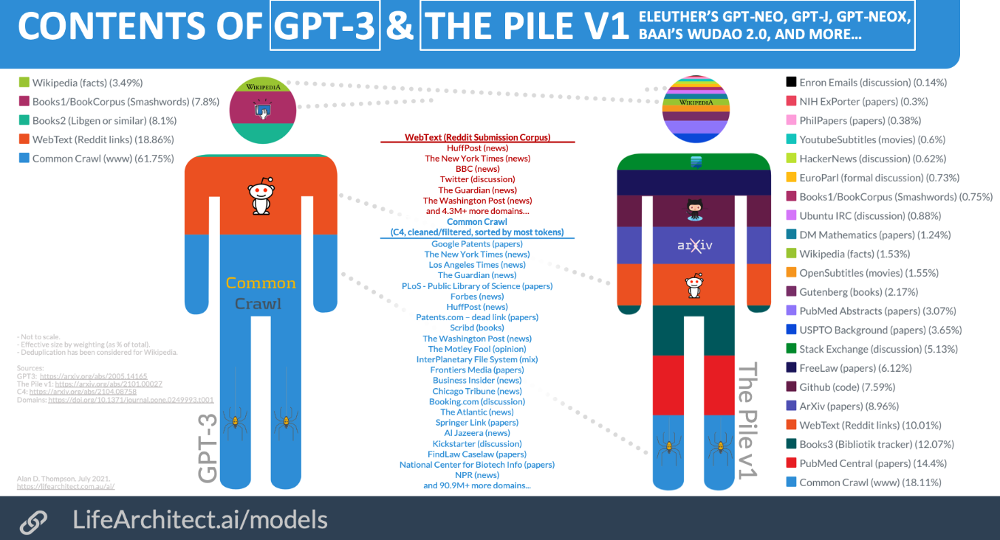

In [52]:
Image('../images/gpt3_the_pile.png')

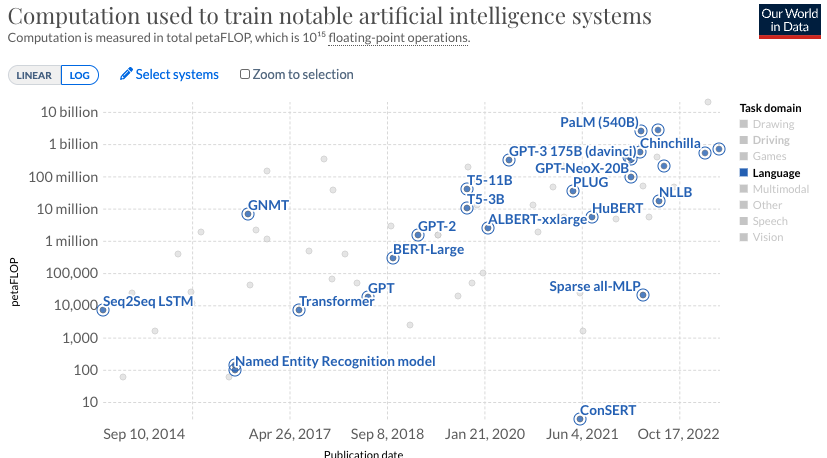

In [18]:
Image('../images/model_petaflops.png')

__Lineage of Chat-GPT__

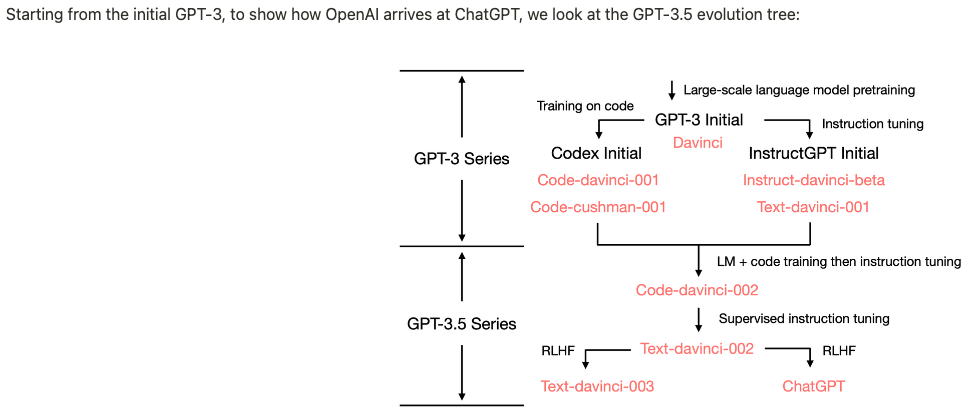

In [53]:
Image('../images/gpt_lineage.png')

taken from: [How does GPT Obtain its Ability?](https://yaofu.notion.site/How-does-GPT-Obtain-its-Ability-Tracing-Emergent-Abilities-of-Language-Models-to-their-Sources-b9a57ac0fcf74f30a1ab9e3e36fa1dc1#929906a4292b4cceadabd92c47f3843f)

### [Google-Researcher "We Have No Moat, And Neither Does OpenAI"](https://www.semianalysis.com/p/google-we-have-no-moat-and-neither)

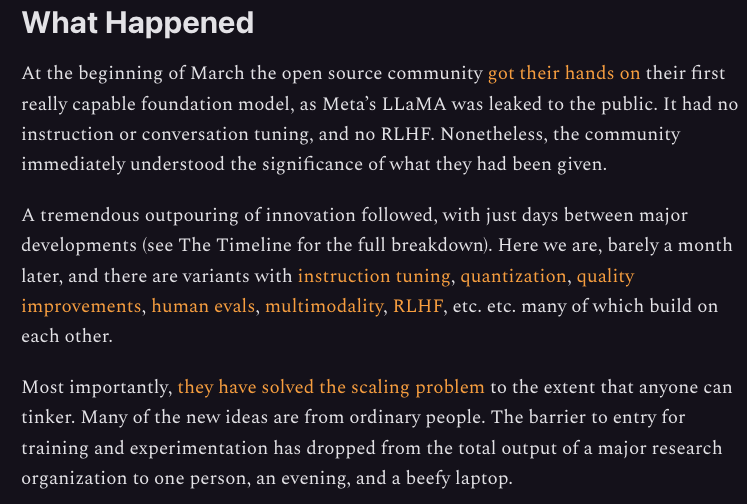

In [83]:
Image('../images/no_moat.png', width=800)

[__LLaMA by Touvron et al.,2023__](https://arxiv.org/abs/2302.13971)

Why is Meta open-sourcing LLMs?
https://twitter.com/ylecun/status/1707656984848478361?t=haxCH62Bmi6Imopw1PN97Q&s=03

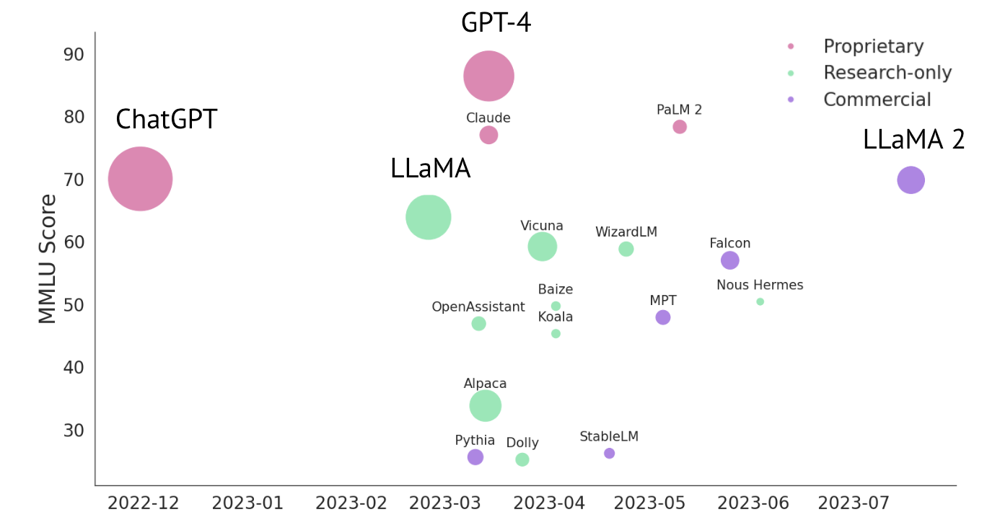

In [5]:
Image('../images/state_of_ai.png')
# https://docs.google.com/presentation/d/156WpBF_rGvf4Ecg19oM1fyR51g4FAmHV3Zs0WLukrLQ/edit#slide=id.g24daeb7f4f0_0_3611

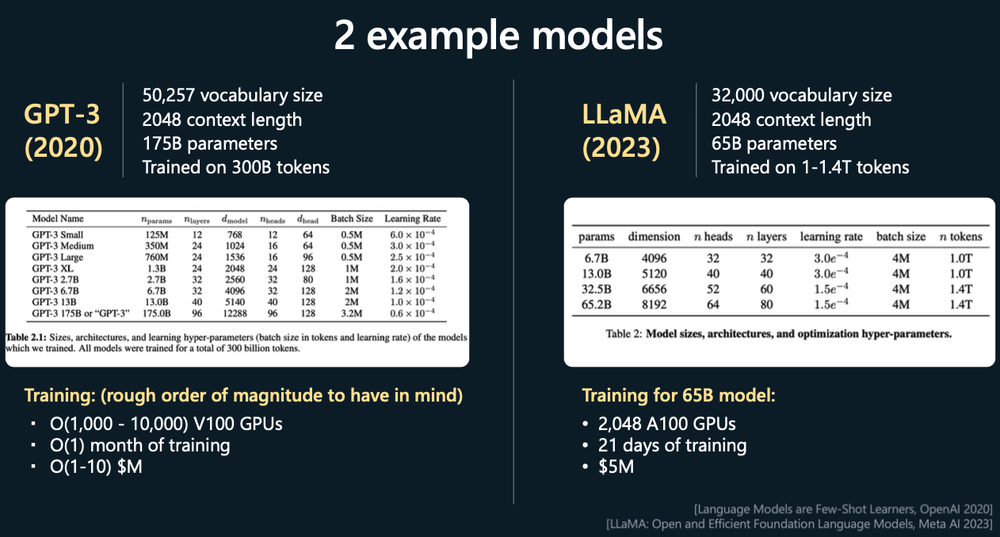

In [103]:
Image('../images/LLaMA_GPT3.png')

taken from [Andrej Karpathy](https://karpathy.ai/stateofgpt.pdf)

### [Alpaca](https://crfm.stanford.edu/2023/03/13/alpaca.html)

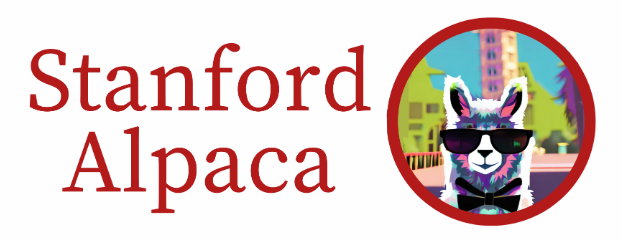

In [22]:
Image('../images/alpaca.png')

Distilling ChatGPT: "Our data generation process results in 52K unique instructions and the corresponding outputs, which costed less than $500 using the OpenAI API."

### [Vicuna](https://lmsys.org/blog/2023-03-30-vicuna/)
"After fine-tuning Vicuna with 70K user-shared ChatGPT conversations, we discover that Vicuna becomes capable of generating more detailed and well-structured answers compared to Alpaca"<br>
Costs: $300

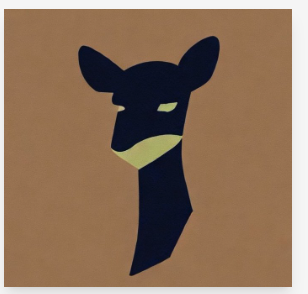

In [23]:
Image('../images/vicuna_logo.png')

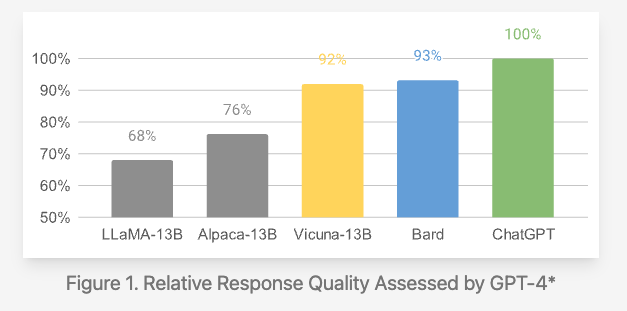

In [24]:
Image('../images/vicuna.png')

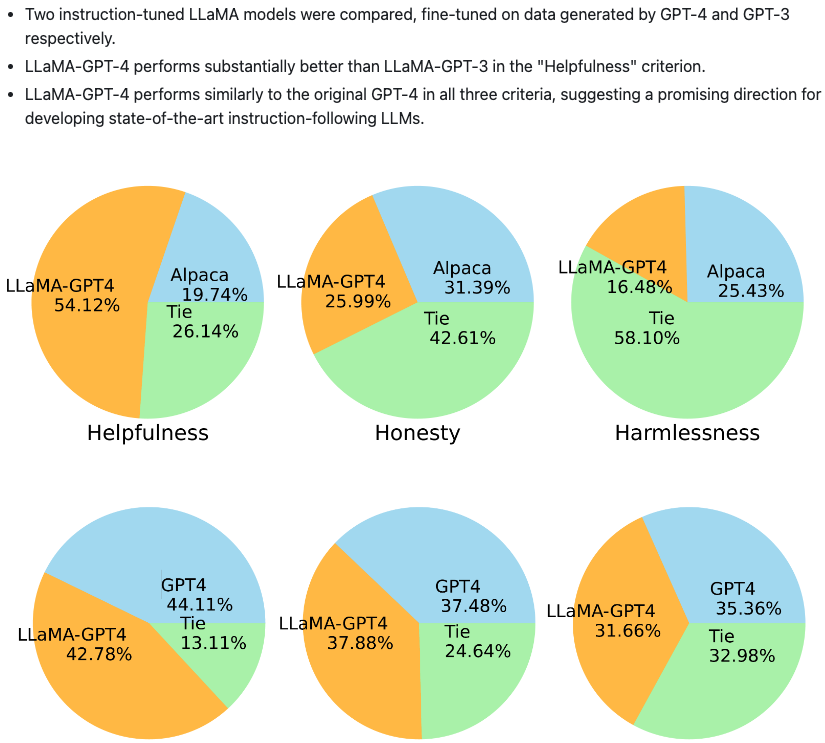

In [75]:
Image('../images/stealing_ChatGPT4.png', width=540)

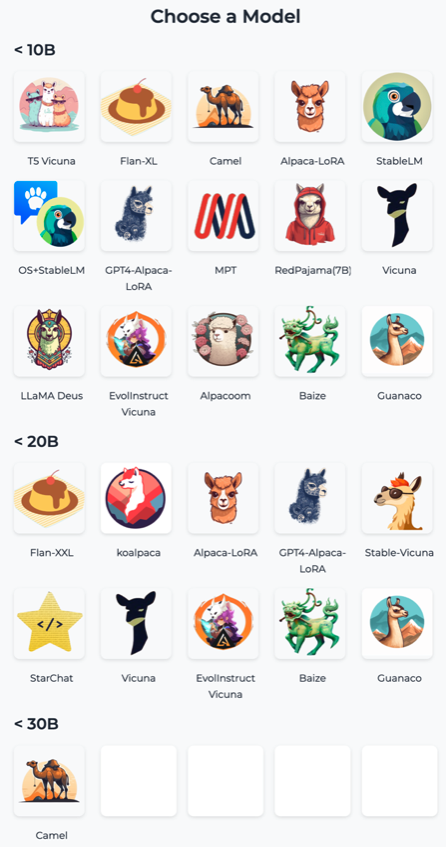

In [99]:
Image('../images/oss_model_zoo.png')

Here is a [link](https://huggingface.co/spaces/HuggingFaceH4/open_llm_leaderboard) to the 'open source' models and there performance.

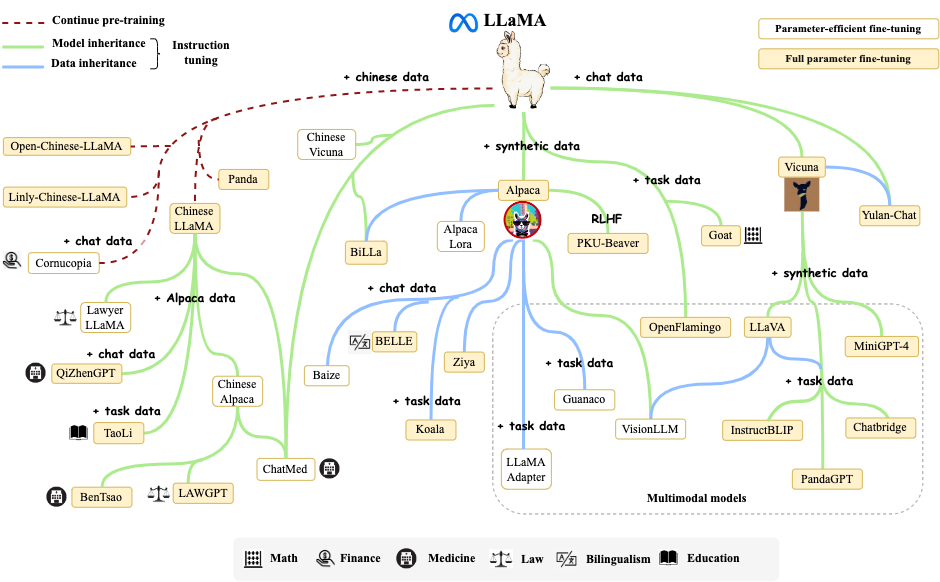

In [9]:
Image('../images/llama_final.png')

### What did the open-source community solve?

__LORA (Low-Rank-Adaptation)__<br>
[This](https://arxiv.org/abs/2106.09685) is corresponding paper.

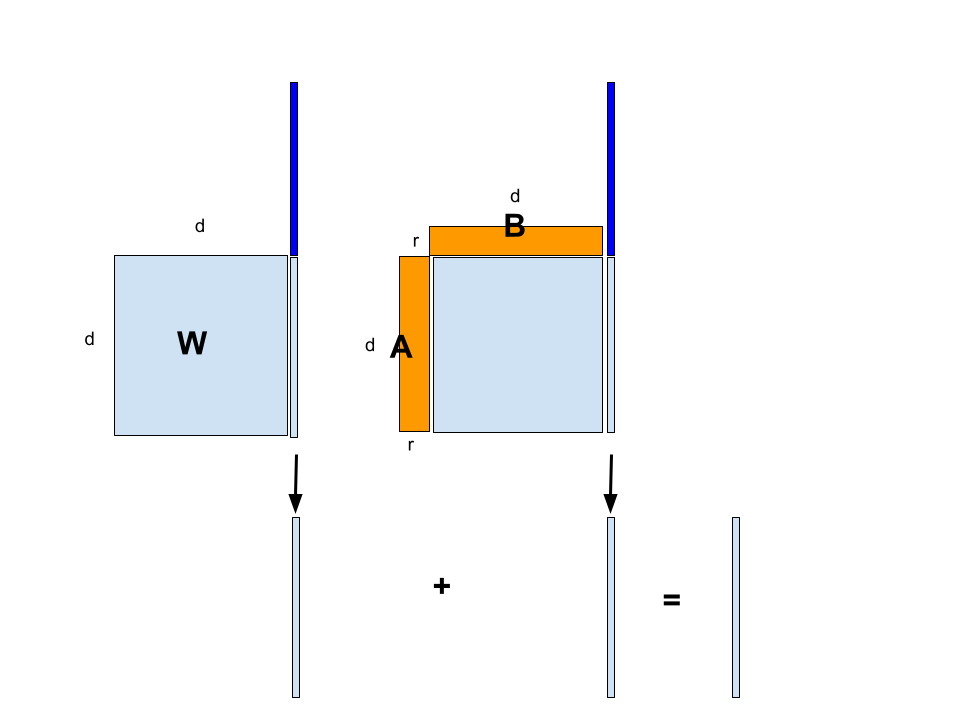

In [76]:
Image('../images/lora.png', width=440, height=440)

The pretrained weight matrix $\mathbf{W}$ is frozen during training. An additional weight matrix is trained with the two low-rank (r) matrices $\mathbf{A}$ and $\mathbf{B}$. Only these weights (orange) are update. The input-vector (dark-blue) is multiplied with the frozen weights as well as with the low-rank-adaption of the weight matrix. The Results are just added. <br>
During training only the gradients for the orange matrices have to be kept in GPU-memory.

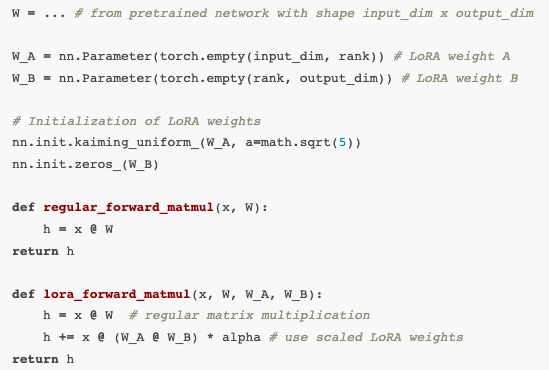

In [79]:
Image('../images/lora_code.png', width=580)

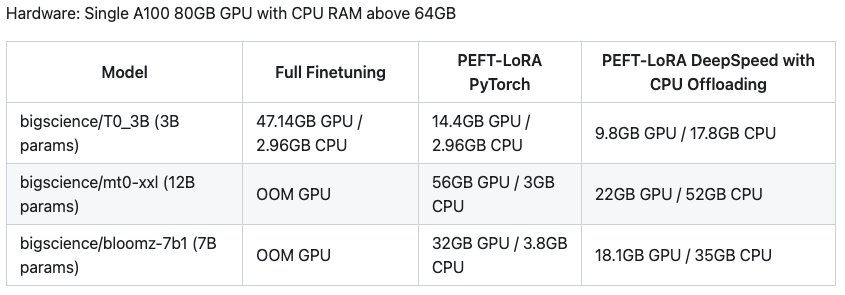

In [80]:
Image('../images/lora_peft.png')

taken from [Sebastian Raschka](https://sebastianraschka.com/blog/2023/llm-finetuning-lora.html)

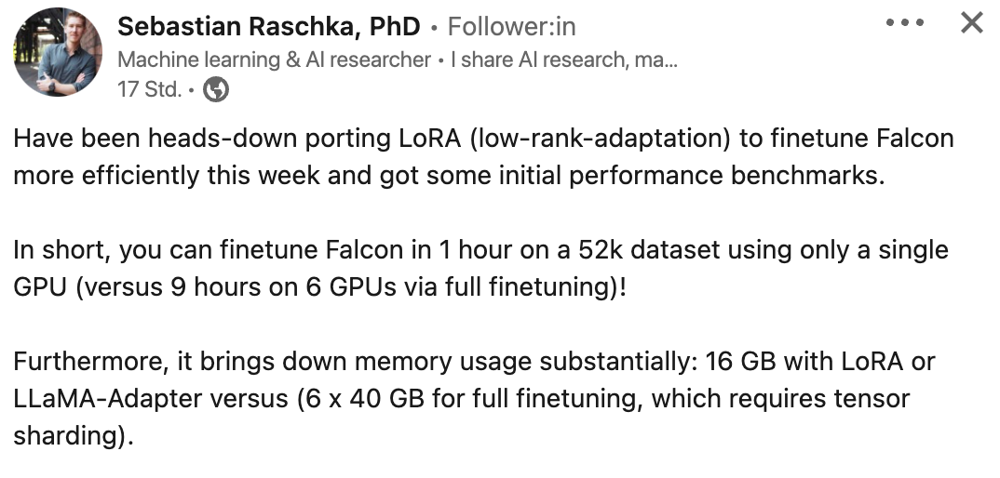

In [89]:
Image('../images/rasbt_lora.png', width=800)

__Bits and Bytes__<br>
[Tim Dettmers et al., 2022](https://arxiv.org/abs/2208.07339) 

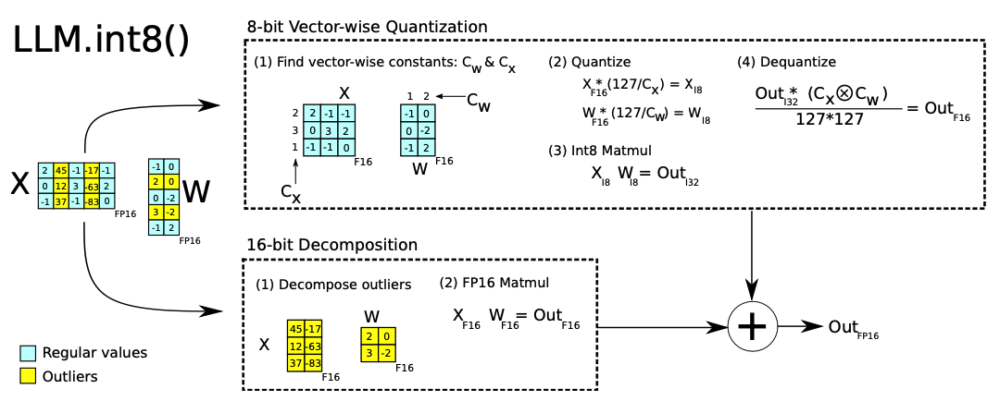

In [27]:
Image('../images/bits_and_bytes.png')

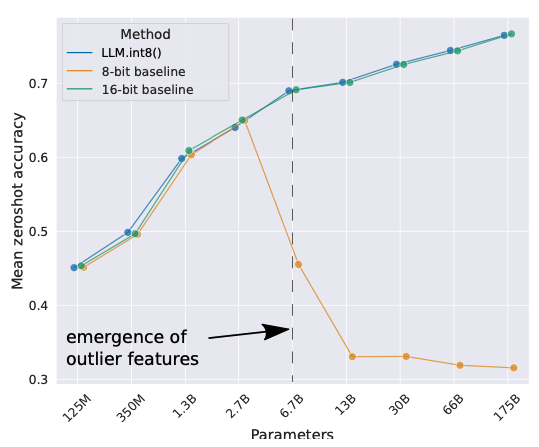

In [28]:
Image('../images/bits_and_bytes2.png')

__[QLora by Dettmers et al., 2023](https://arxiv.org/abs/2305.14314)__<br>
In few words, QLoRA reduces the memory usage of LLM finetuning without performance tradeoffs compared to standard 16-bit model finetuning. This method enables 33B model finetuning on a single 24GB GPU and 65B model finetuning on a single 46GB GPU. [see here](https://huggingface.co/blog/4bit-transformers-bitsandbytes)

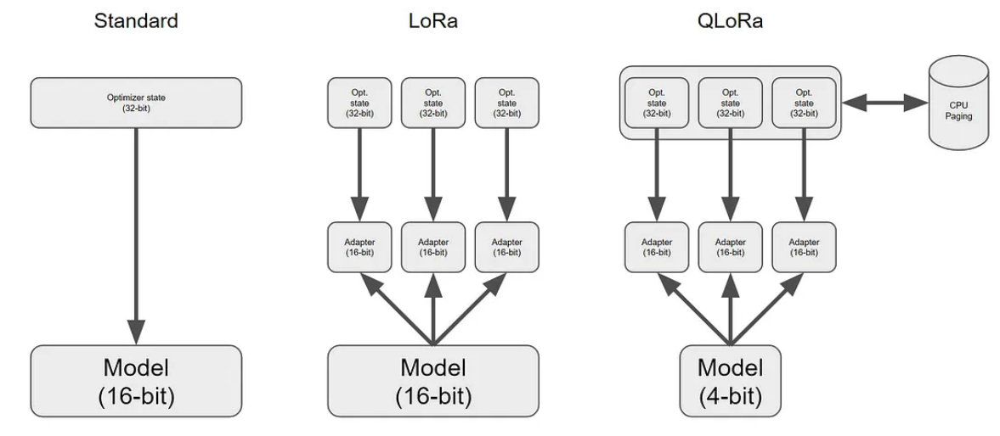

In [29]:
Image('../images/qlora.png')

illustration taken from [here](https://towardsdatascience.com/qlora-fine-tune-a-large-language-model-on-your-gpu-27bed5a03e2b)

[__SpQR by Dettmers et al., 2023__](https://arxiv.org/abs/2306.03078) This is not for training but for inference

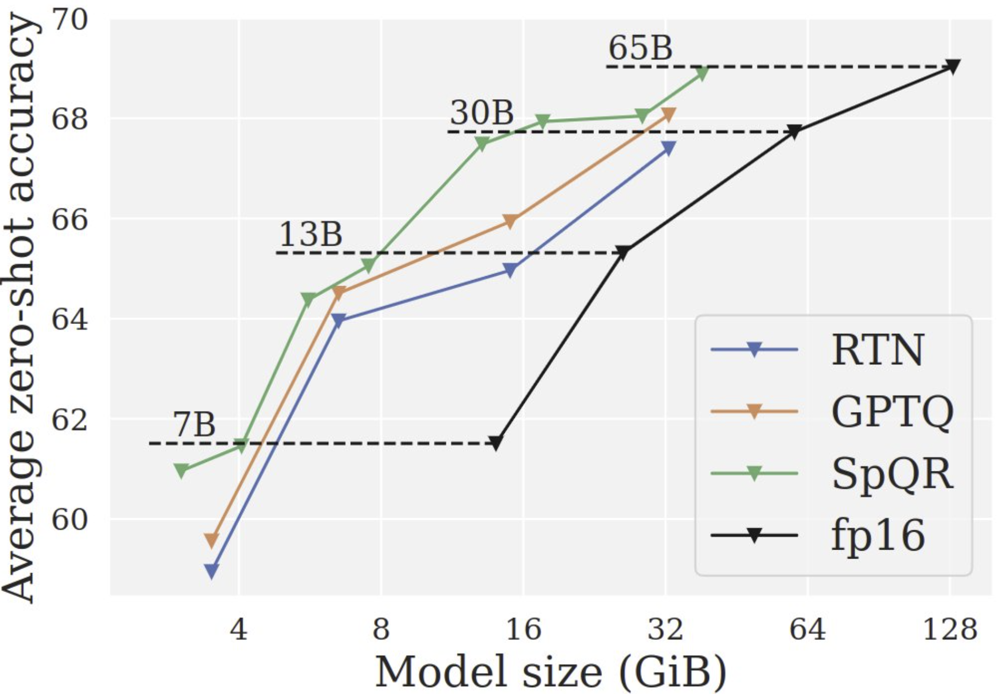

In [14]:
Image('../images/SpQR.png', width=520)

"Specifically, we provide an efficient GPU inference algorithm for SpQR which yields faster inference than 16-bit baselines at similar accuracy, while enabling memory compression gains of more than 4x."

### [LLaMA cpp](https://github.com/ggerganov/llama.cpp)
Plain C/C++ implementation without dependencies<br>
 - LLMs quantized on edge devices
 - on Apple hardware
 - no training, just inference

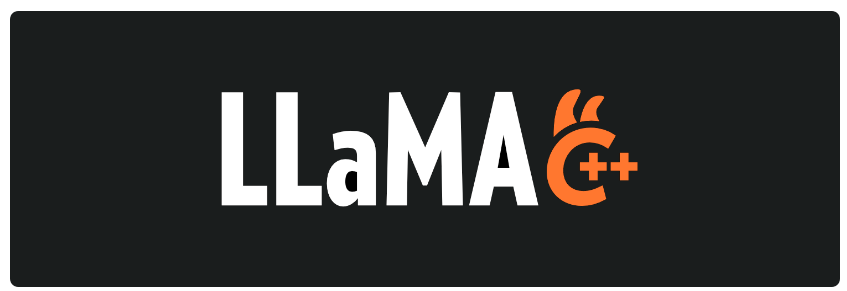

In [30]:
Image('../images/lama_cpp.png')

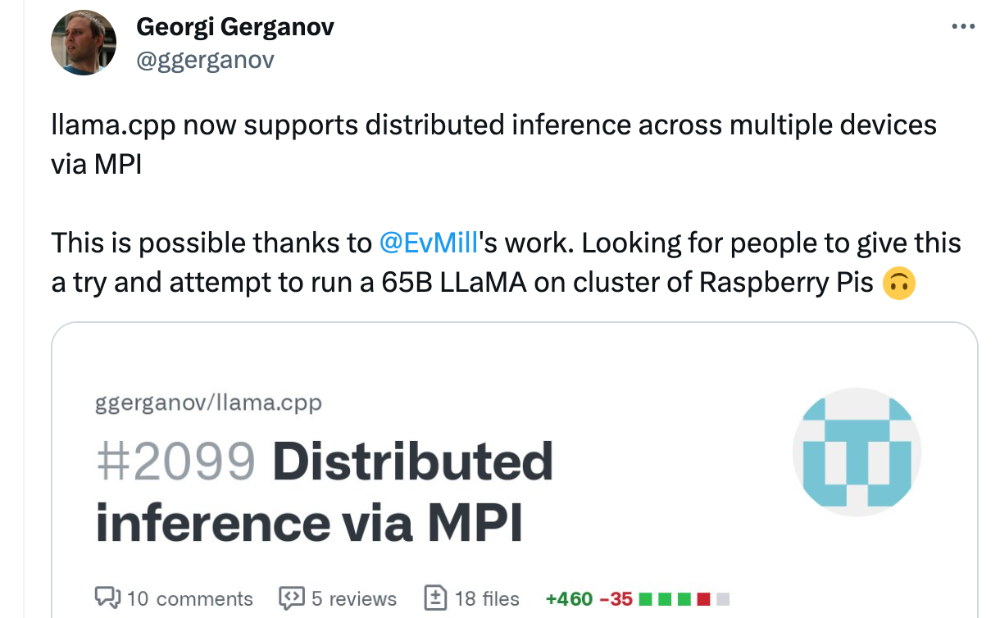

In [11]:
Image('../images/llama_cpp_mpi.png')

### MLC

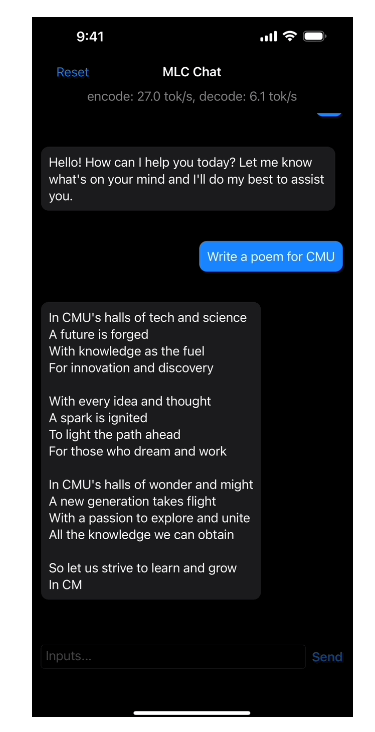

In [100]:
Image('../images/MLC.png')

## Prompt Engineering
Prompt Engineer will not be a job to stay.<br>

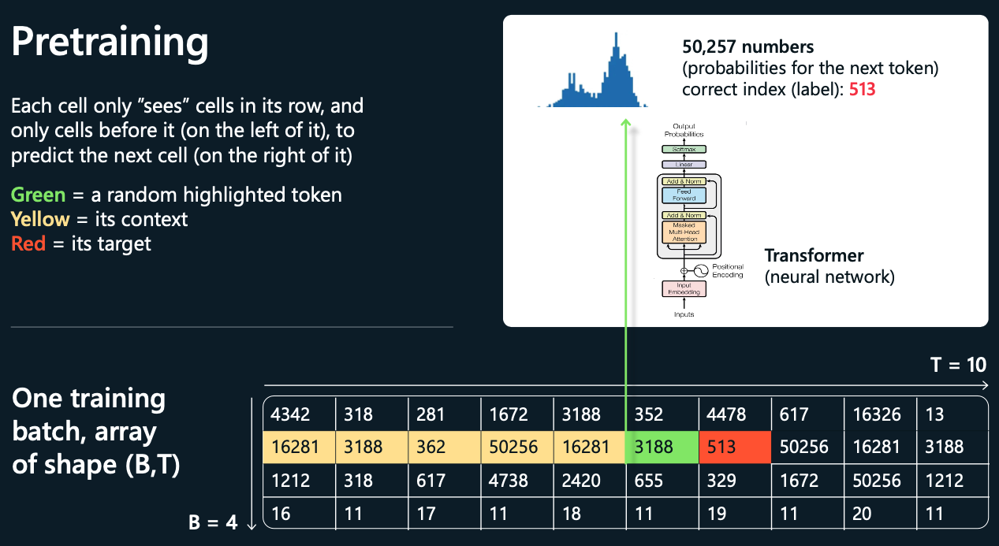

In [104]:
Image('../images/condition_on_context.png')

taken from [Andrej Karpathy](https://karpathy.ai/stateofgpt.pdf)

From [Mishra et al., 2022](https://arxiv.org/pdf/2109.07830.pdf):<br>
 - *Use Low-level Patterns*: Instead of using terms that require background knowledge to understand, use various patterns about the expected output.
 - *Itemizing Instructions*: Turn descriptive attributes into bulleted lists. If there are any negation statements, turn them into assertion statements.
 - *Break it Down*: Break down a task into multiple simpler tasks, wherever possible.
 - *Enforce Constraint*: Add explicit textual statements of output constraints.
 - *Specialize the Instruction*: Customize the instructions so that they directly speak to the intended output.
 

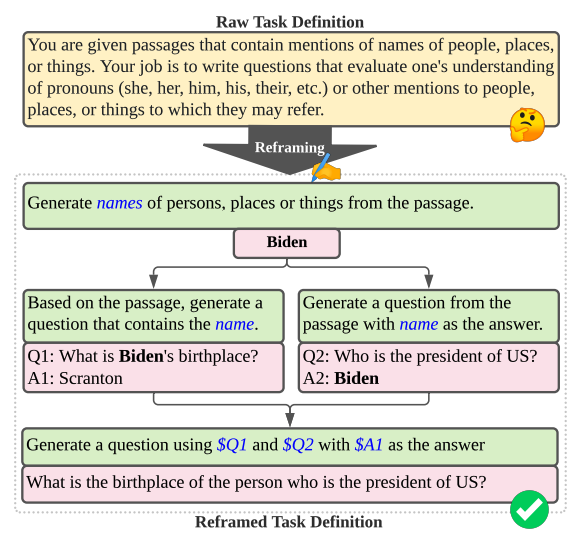

In [31]:
Image('../images/mishra.png')

__Prompting is only to imitate as well as possible the training data.__

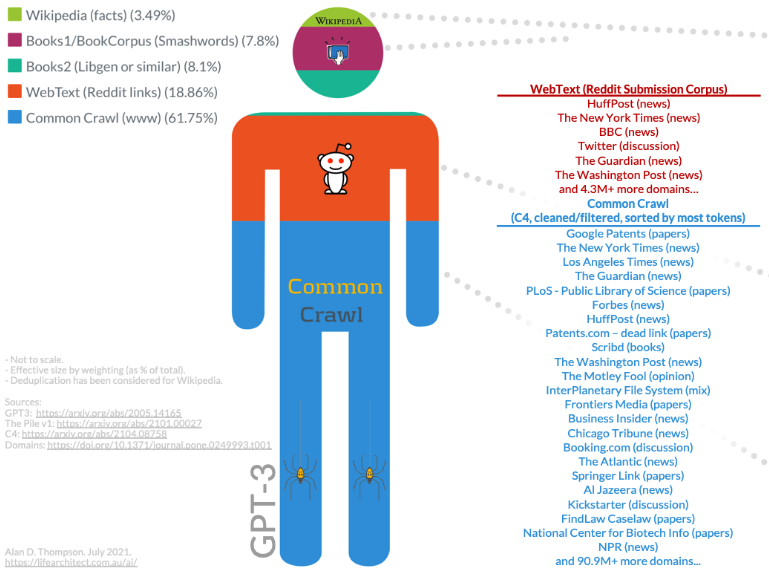

In [39]:
Image('../images/gpt_training.png')

__Fiction__<br>
Since most models are also trained on one or several book corpora, they can also be prompted to take on a fictional persona.

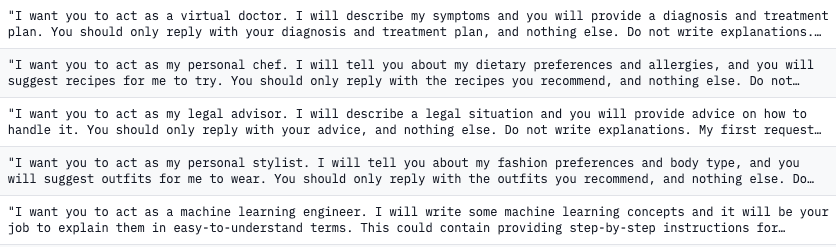

In [36]:
Image('../images/fictional.png')

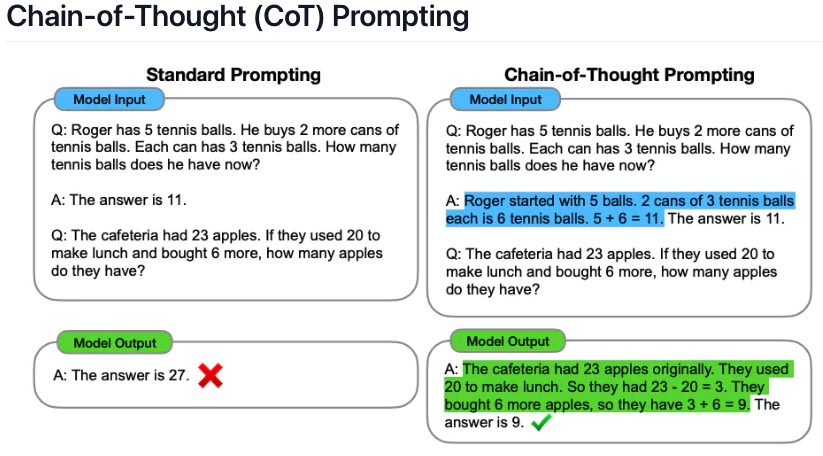

In [40]:
Image('../images/COT_prompting.png')

__Zero-Shot CoT prompting__<br>
Let's think step by step

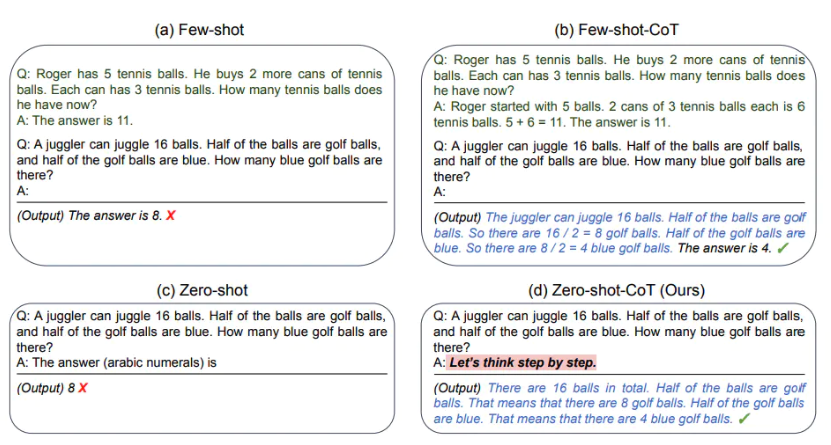

In [41]:
Image('../images/zeroCOT_prompting.png')

__Remember Byte-Pair-Encoding:__

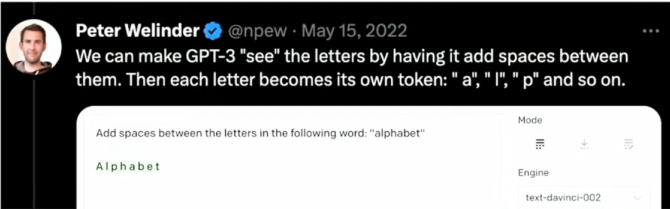

In [42]:
Image('../images/characters.png')

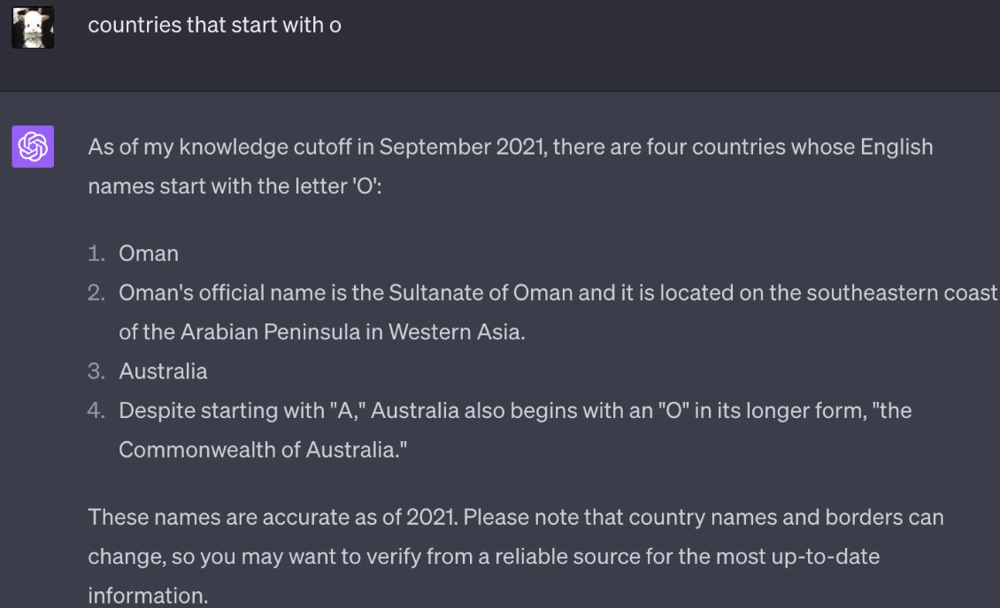

In [86]:
Image('../images/countries_with_o.png', width=820)

For more funny examples with "O" see this [twitter feed](https://twitter.com/DahnJahn/status/1669000659192930304).

__Why Large Language Models can not calculate with large numbers:__

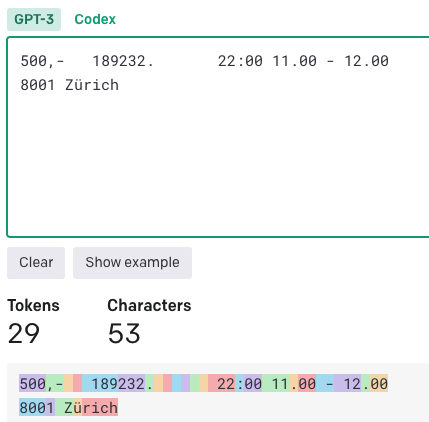

In [87]:
Image('../images/bpe_numbers.png')

### The ultimate solution:

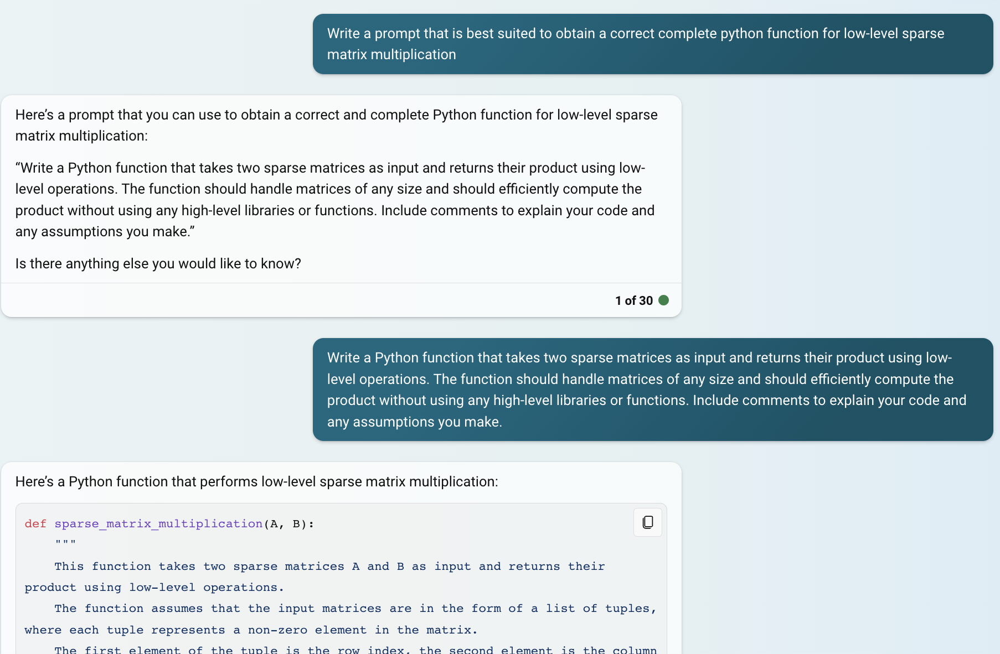

In [97]:
Image('../images/ultimate_prompt.png', width=820)

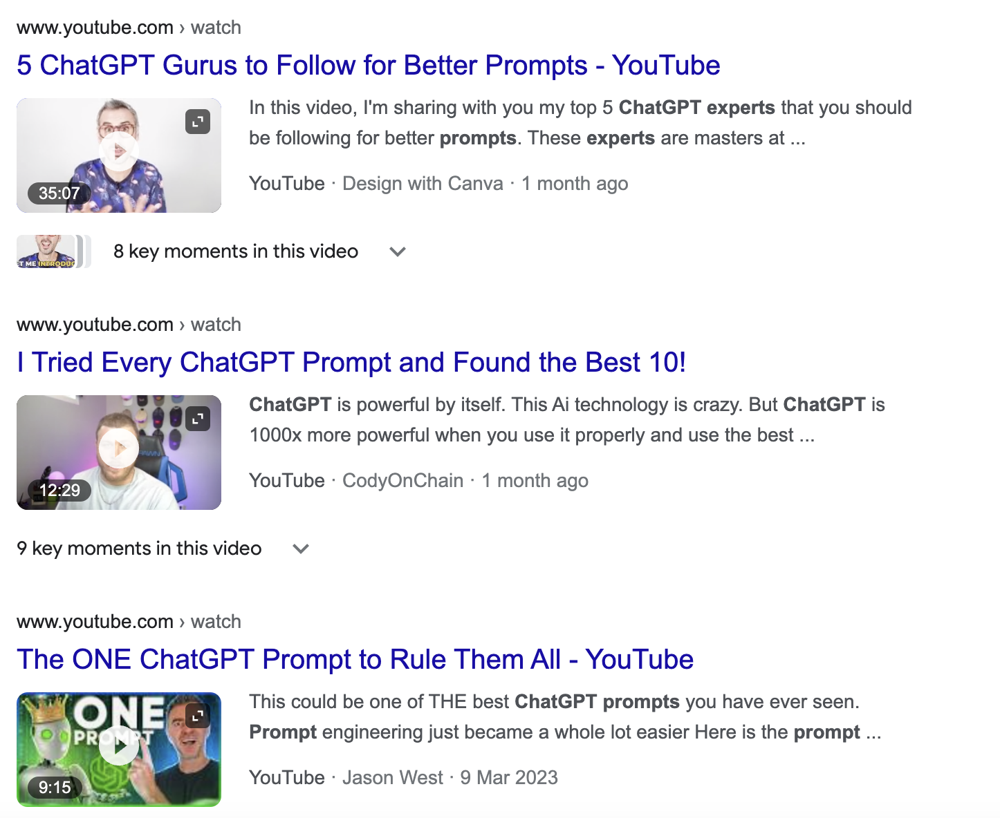

In [98]:
Image('../images/prompt_influencers.png', width=680)

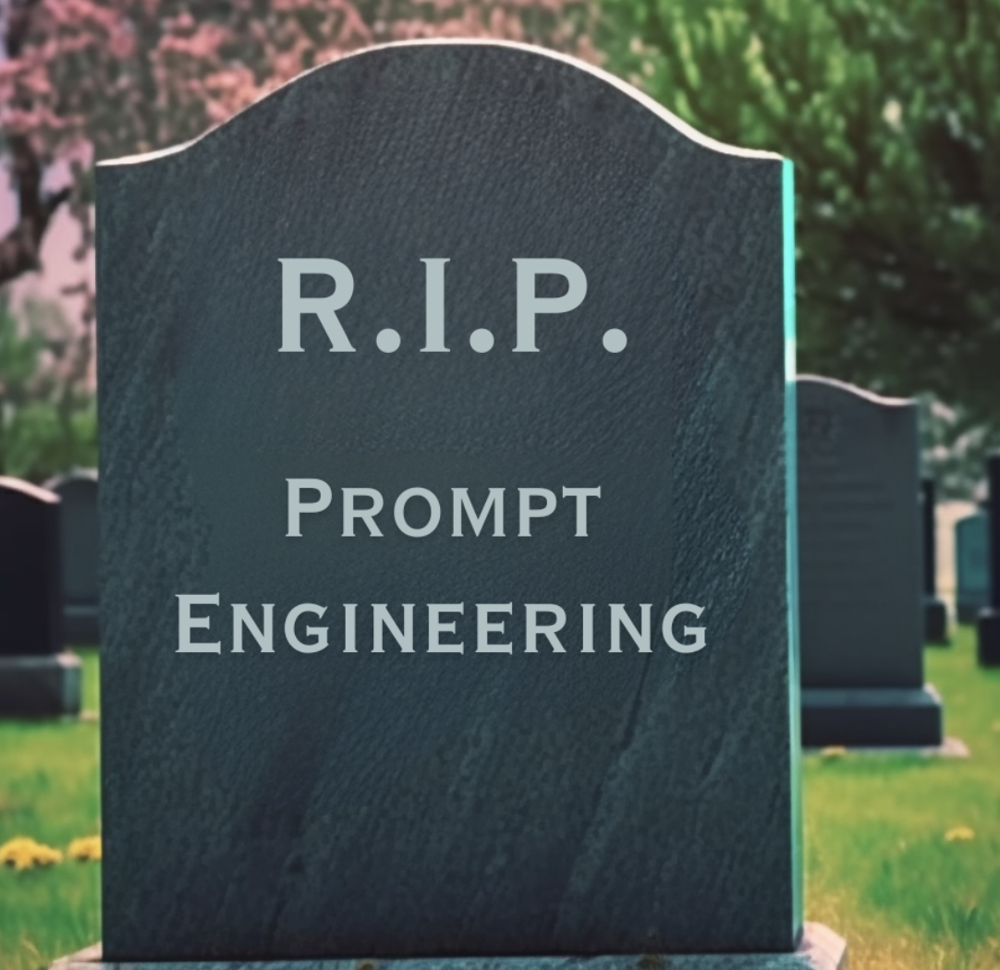

In [96]:
Image('../images/rip_prompt_engineer.png')

### Retrieval-Augmented Generative (RAG) process

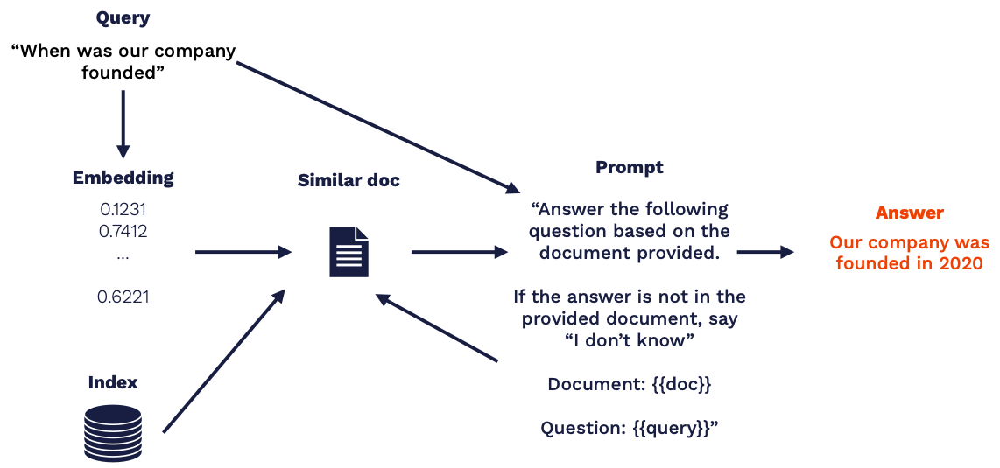

In [4]:
Image('../images/rag.png')

__The rise of vector data-bases__

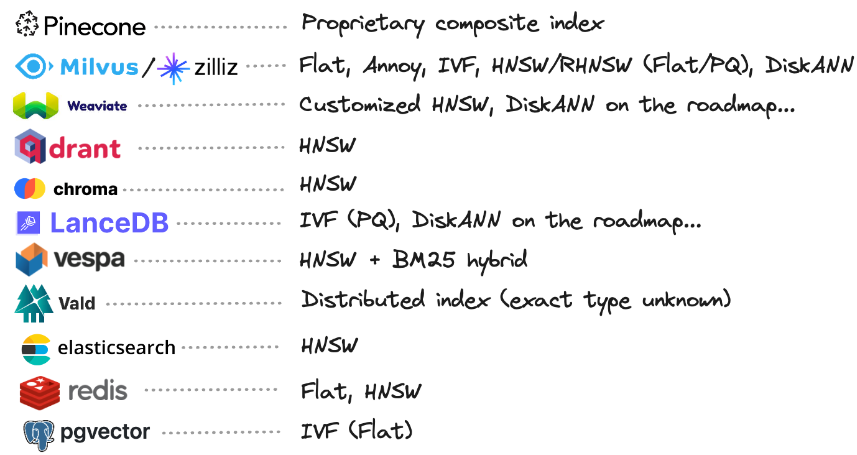

In [3]:
Image('../images/vector_dbs.png')

[taken from here](https://thedataquarry.com/posts/vector-db-1/)

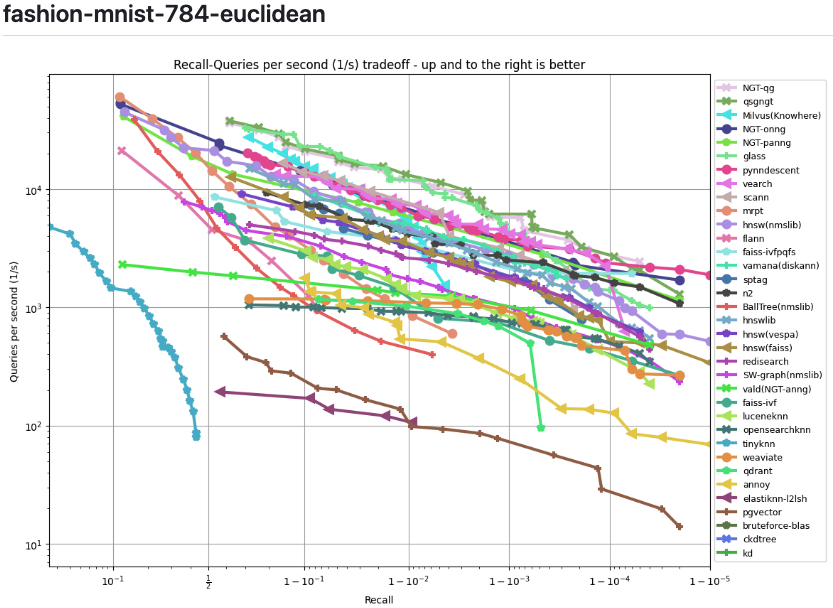

In [4]:
Image('../images/ann.png')

[benchmark can be found here on github](https://github.com/erikbern/ann-benchmarks)

__New research is extending the context length__

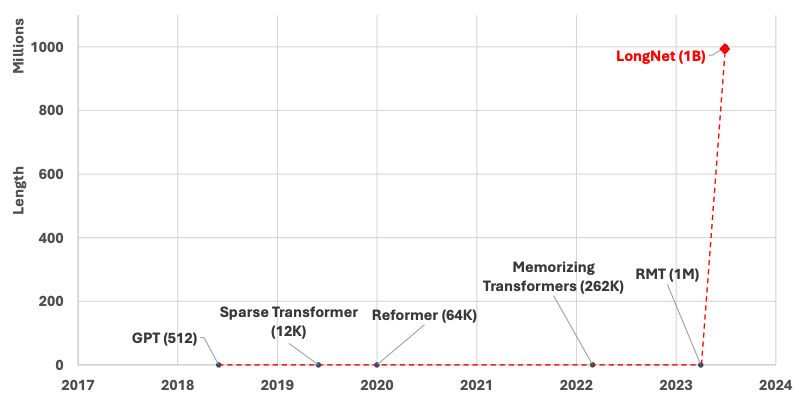

In [8]:
Image('../images/longnet.png')

[taken from the publication](https://arxiv.org/pdf/2307.02486.pdf)

__User:__ Here is the first book of Harry Potter. (book in looong context) Read it and describe the main characters!

__ChatBot:__ 

  1. *Harry Potter*, the protagonist of the story, who is marked with a lightning scar and destined to fight the evil Lord Voldemort

  2. *Hermione Granger*, Harry’s best friend and a brilliant witch who excels at academics and logic

  3. *Ron Weasley*, Harry’s other best friend and a loyal and brave wizard from a large family

  4. *Albus Dumbledore*, the headmaster of Hogwarts and a powerful and wise wizard who guides and mentors Harry

  5. *Lord Voldemort*, the main antagonist of the story, who is a dark wizard who seeks to destroy Harry and conquer the wizarding world

__User:__ Now, explain in more detail the role of Albus Dumbledore.

__ChatBot:__ Can you give me the book again? I first have to read it.

__research in progress: agents__

There are specialized models for:
 - writing sql-queries
 - querying APIs (just feed them the documentation)
 - coding
 - generating images from text-prompts
 - generating real human voice (in your prefered language)
 - transcribing audio files
 - OCR
 - etc...

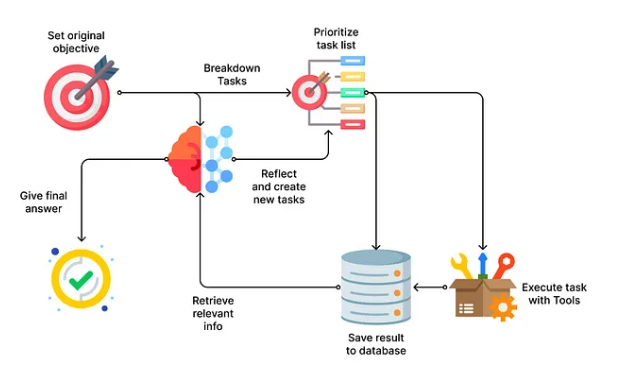

In [6]:
Image('../images/agents.png')

[image is taken from here](https://bootcamp.uxdesign.cc/a-comprehensive-and-hands-on-guide-to-autonomous-agents-with-gpt-b58d54724d50)

### How should a company like Contovista / Finnova position itself?
(summary of [Leadership needs us to do
Gen AI, what do we do?](https://huyenchip.com/assets/genai.pdf))

__1. Set expectations:__

 - Building cool demos with LLMs is easy
 - But it's hard to build a real product with LLMs
 - Build up some intern competencies (just experiment)
 - set goals and expectation for real products
 - be willing to invest



__2. Minimize risk:__

__Analyze:__

 - Can competitors with generative AI make me obsolete? How fast will competitors move? <br>
   -> __Go all in__
 - I'll miss opportunities to boost revenue? -> Build or buy
 
__Have a data strategy:__

 - consolidate existing data
 - ensure data quality and data governance
 
__Avoid big sweeping decisions:__

 - don't change everything
 - invest in things that last

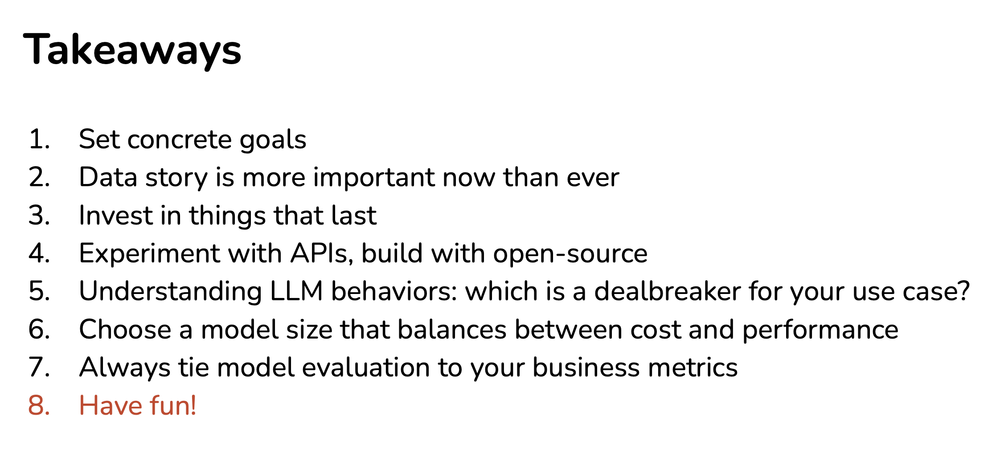

In [5]:
Image('../images/takeaways.png')

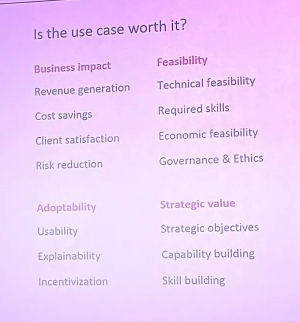

In [5]:
Image('../images/is_the_case_worth_it.png')

https://www.linkedin.com/posts/yangpeter_everyones-pivoting-to-generative-ai-but-activity-7073305428255789056-l9Ns/?utm_source=share&utm_medium=member_android

Here are 5 questions to ask to understand if a gen AI product will be successful:

1/ If you took the word "AI" out, is the product still solving a customer problem?

AI is a solution, not a problem.

Ask yourself:

1. What is the pain point?
2. How many users share this pain?
3. Is the pain big enough to take action?
4. Is the pain underserved by non-AI tools?

2/ How accurate does the solution need to be?

Plot the problem on a fluency vs. accuracy grid.

Gen AI today is great for high fluency + low accuracy problems (e.g., productivity).

It's not great for solutions that need high accuracy (e.g., financial decisions).

3/ How fast will incumbents move?

Incumbents like Microsoft, Google, and Adobe have moved incredibly fast on AI.

Startups that overlap with core incumbent use cases might struggle.

e.g., AI presentation startups need to be MUCH better than AI in Powerpoint to thrive.

4/ Is there a moat?

Examples moats include:

- Access to proprietary data and models
- Exclusive contracts with large customers
- Great product even without AI
- Exceptional talent in the selected field
- Business models that incumbents avoid

And of course...speed of execution.

5/ Is it overvalued?

If an AI product already has $100M+ valuation, you should think:

Can it continue to grow and (more importantly) retain users?

In a crowded space like AI copywriting and productivity - that could get hard.

6/ To recap, here are 5 questions to ask to evaluate AI products and companies:

1. Without "AI", is it still solving a problem?
2. How accurate does the solution need to be?
3. How fast will incumbents move?
4. Is there a moat?
5. Is it overvalued?

7/ I hope these questions also help builders who are thinking of creating new AI products.


### Follow-up on Llama-2:
https://simonwillison.net/2023/Aug/3/weird-world-of-llms/

https://simonwillison.net/2023/Aug/27/wordcamp-llms/

https://magazine.sebastianraschka.com/p/ahead-of-ai-11-new-foundation-models